In [1]:
#@title Doing Monte Carlo
!pip install numpy pandas pandas-datareader matplotlib seaborn scipy yfinance
import numpy as np
import pandas as pd
import statistics
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import norm
import yfinance as yf
from datetime import datetime, timedelta

In [4]:
#@title Monte Carlo Simulation functions for given Ticker, Start and End date, number of Prediction days
class Monte_Carlo_Sim():

    def __init__(self, ticker, start_date, end_date, nr_of_days, nr_of_sim):
        self.ticker = ticker
        self.start_date = start_date
        self.end_date = end_date
        self.nr_of_sim = nr_of_sim
        self.nr_of_days = nr_of_days

        self.download_stock_data()
        self.capture_daily_returns()
        self.calculate_volatility()
        self.execute_monte_carlo()

    def download_stock_data(self):
        self.data = pd.DataFrame()

        # Using Yahoo Finance to download stock data
        stock = yf.Ticker(self.ticker)
        self.data = stock.history(start=self.start_date, end=self.end_date)

        # Check if the DataFrame is empty and print info if it is.
        if self.data.empty:
            print(f"Dataframe for ticker {self.ticker} is empty. Check data availability for the given date range.")
            print(f"Start date: {self.start_date}, End date: {self.end_date}")
            return  # Stop execution if data is empty

        self.data.to_csv(f"{self.ticker}_stock_data.csv")


    def capture_daily_returns(self):

        # calculate daily returns from Close price
        self.daily_returns = np.log(1 + self.data['Close'].pct_change())
        self.daily_returns = self.daily_returns[1:]

    def calculate_volatility(self):
        self.daily_volatility = np.std(self.daily_returns)

    def execute_monte_carlo(self):
        # Check if self.data is empty before accessing it.
        if self.data.empty:
            print(f"Dataframe for ticker {self.ticker} is empty. Monte Carlo simulation cannot be executed.")
            return

        # Get the last days stock price
        last_price = self.data['Close'].iloc[-1]
        self.last_price = last_price

        # Initialize a list to store all simulation results
        all_simulations = []

        for x in range(self.nr_of_sim):
            price_series = [last_price]

            for y in range(1, self.nr_of_days):
                price = price_series[-1] * (1 + np.random.normal(0, self.daily_volatility))
                price_series.append(price)

            all_simulations.append(price_series)

        # Convert the list of simulations into a DataFrame all at once
        self.simulation_df = pd.DataFrame(all_simulations).transpose()


    def calculate_percentile_price_for_days(self):
        for i in range(0,self.nr_of_days):
            #print(f"simulation day {i} stdev: {statistics.stdev(simulation_df.iloc[i])}")
            # calulate next day from end_date
            next_business_day = pd.to_datetime(self.end_date) + pd.offsets.BDay(1 + i)
            #print(f"The next business day after {end_date} is {next_business_day.strftime('%Y-%m-%d')}")
            # Extract the prices for the next
            # Extract the prices for the next day after end_date
            next_day_price = self.simulation_df.iloc[0 + i]

            # Calculate the 95% confidence interval
            lower_bound = np.percentile(next_day_price, 2.5)
            upper_bound = np.percentile(next_day_price, 97.5)
            # Calculate the mean (expected) price
            mean_price = np.mean(next_day_price)
            # 98% CI price
            lower_bound_98 = np.percentile(next_day_price, 1)
            upper_bound_98 = np.percentile(next_day_price, 99)
            # Print the results
            print(f"{self.ticker}: The mean price {next_business_day.strftime('%Y-%m-%d')} is: {round(mean_price,2)}, The 95% CI price: ({round(lower_bound,2)}, {round(upper_bound,2)}), The 98% CI price: ({round(lower_bound_98,2)}, {round(upper_bound_98,2)})")

    def plot_CI_price(self):
        # plot 90% CI, 95% CI, 98% CI and the mean price for each day
        forecast_dates = pd.date_range(start=self.end_date, periods=self.nr_of_days + 1, freq='B')[1:]

        # Calculate mean and confidence intervals along the correct axis (axis=1 for row-wise)
        mean_price = self.simulation_df.mean(axis=1)

        # Calculate confidence intervals for each day
        ci_90 = np.array([np.percentile(self.simulation_df.iloc[i], [5, 95]) for i in range(self.nr_of_days)])
        ci_95 = np.array([np.percentile(self.simulation_df.iloc[i], [2.5, 97.5]) for i in range(self.nr_of_days)])
        ci_98 = np.array([np.percentile(self.simulation_df.iloc[i], [1, 99]) for i in range(self.nr_of_days)])

        # Plot the results
        plt.figure(figsize=(20, 10))
        plt.plot(forecast_dates, mean_price, label='Mean Price', color='blue', linestyle='-', linewidth=2)

        # Annotate values
        for date, price in zip(forecast_dates, mean_price):
            plt.text(date, price, f'{price:.2f}', ha='center', va='bottom')

        # Plot Confidence Intervals, using the transposed CI data
        plt.fill_between(forecast_dates, ci_90[:, 0], ci_90[:, 1], color='blue', alpha=0.2, label='90% Confidence Interval')
        plt.fill_between(forecast_dates, ci_95[:, 0], ci_95[:, 1], color='green', alpha=0.2, label='95% Confidence Interval')
        plt.fill_between(forecast_dates, ci_98[:, 0], ci_98[:, 1], color='red',  alpha=0.2, label='98% Confidence Interval')

        # Labels and title
        plt.title(f"Monte Carlo Simulation: {self.ticker} Stock Price with Confidence Intervals 90, 95 and 98")
        plt.xlabel('Date')
        plt.ylabel('Predicted mean/CI ($)')
        plt.xticks(rotation=90)
        plt.legend()
        plt.tight_layout()
        plt.show()


    def simulation_plot(self):
        self.simulation_df.plot(legend=False, figsize=(15, 6))
        plt.suptitle(f'Monte Carlo Simulation result for: {self.ticker}')
        forecast_dates = pd.date_range(start=self.end_date, periods=self.nr_of_days + 1, freq='B')[1:]  # Skip the start date and generate business days
        # Set the x-ticks to be the forecast dates
        plt.xticks(ticks=np.arange(self.nr_of_days), labels=forecast_dates.strftime('%Y-%m-%d'))
        plt.xticks(rotation=90)
        plt.axhline(y=self.last_price, color='red', linestyle='--', label=f'Last Price: {self.last_price}')
        plt.xlabel('Day')
        plt.ylabel('Price')
        plt.grid(True)
        plt.show()


    def plot_stock_data_column(self, column):
        plt.figure(figsize=(15, 6))
        plt.plot(self.data[column], label=f'{column}')
        plt.title(f'{column} of {self.ticker} Since {self.start_date} to {self.end_date}')
        plt.xlabel('Date')
        plt.ylabel(f'{column}')
        plt.legend()
        plt.grid(True)


GOOG: The mean price 2025-02-05 is: 202.64, The 95% CI price: (202.64, 202.64), The 98% CI price: (202.64, 202.64)
GOOG: The mean price 2025-02-06 is: 202.6, The 95% CI price: (195.2, 210.16), The 98% CI price: (193.57, 211.76)
GOOG: The mean price 2025-02-07 is: 202.61, The 95% CI price: (192.41, 213.61), The 98% CI price: (190.51, 215.92)
GOOG: The mean price 2025-02-10 is: 202.62, The 95% CI price: (189.58, 216.23), The 98% CI price: (187.56, 218.83)
GOOG: The mean price 2025-02-11 is: 202.62, The 95% CI price: (187.99, 218.08), The 98% CI price: (185.3, 220.79)
GOOG: The mean price 2025-02-12 is: 202.61, The 95% CI price: (186.41, 220.12), The 98% CI price: (182.97, 223.48)
GOOG: The mean price 2025-02-13 is: 202.6, The 95% CI price: (184.52, 222.07), The 98% CI price: (181.33, 224.71)
GOOG: The mean price 2025-02-14 is: 202.55, The 95% CI price: (183.2, 223.39), The 98% CI price: (179.81, 227.41)
GOOG: The mean price 2025-02-17 is: 202.56, The 95% CI price: (182.3, 224.88), The 98

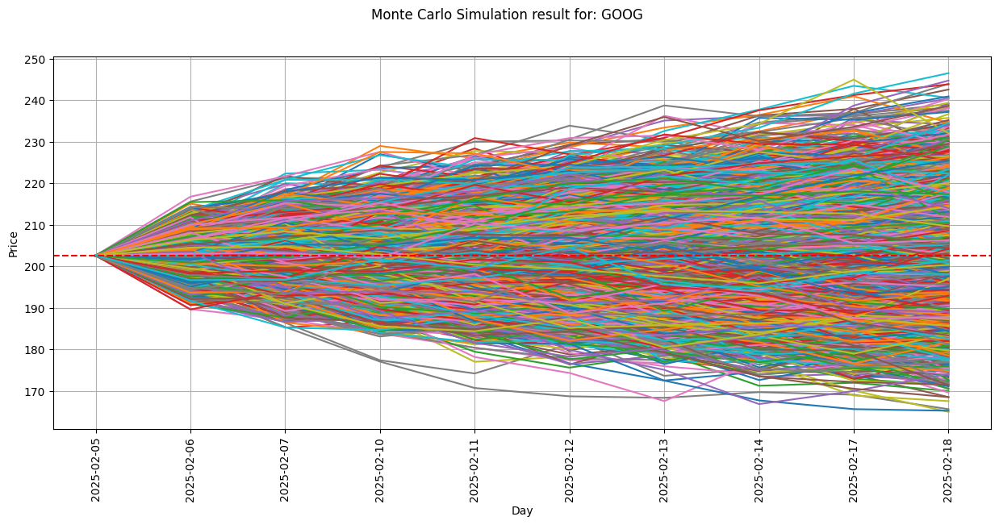

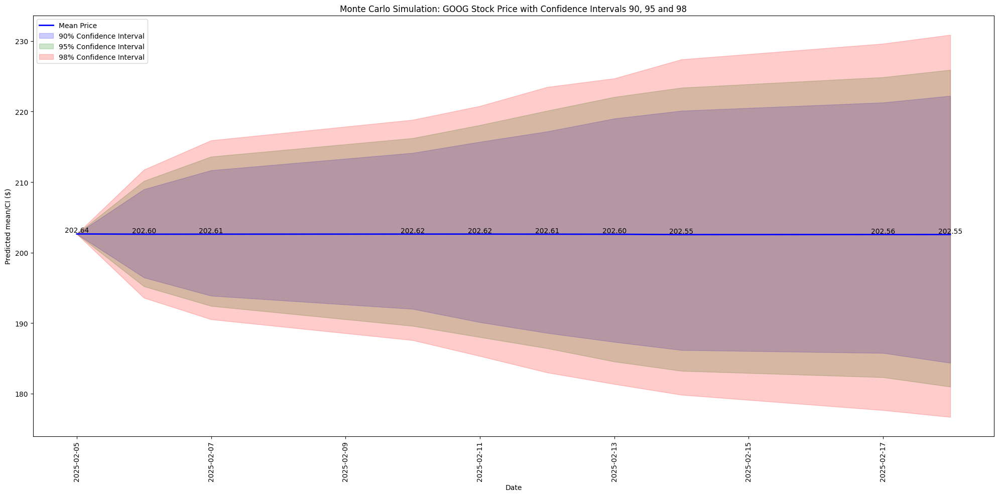

GOOGL: The mean price 2025-02-05 is: 201.23, The 95% CI price: (201.23, 201.23), The 98% CI price: (201.23, 201.23)
GOOGL: The mean price 2025-02-06 is: 201.24, The 95% CI price: (193.57, 208.7), The 98% CI price: (191.93, 210.14)
GOOGL: The mean price 2025-02-07 is: 201.29, The 95% CI price: (190.74, 212.27), The 98% CI price: (188.67, 214.29)
GOOGL: The mean price 2025-02-10 is: 201.27, The 95% CI price: (188.08, 214.61), The 98% CI price: (185.31, 217.35)
GOOGL: The mean price 2025-02-11 is: 201.28, The 95% CI price: (186.34, 216.7), The 98% CI price: (183.62, 219.46)
GOOGL: The mean price 2025-02-12 is: 201.24, The 95% CI price: (184.47, 218.58), The 98% CI price: (181.68, 221.5)
GOOGL: The mean price 2025-02-13 is: 201.18, The 95% CI price: (182.93, 220.44), The 98% CI price: (179.76, 223.78)
GOOGL: The mean price 2025-02-14 is: 201.22, The 95% CI price: (181.7, 221.88), The 98% CI price: (178.18, 226.2)
GOOGL: The mean price 2025-02-17 is: 201.21, The 95% CI price: (180.15, 223.6

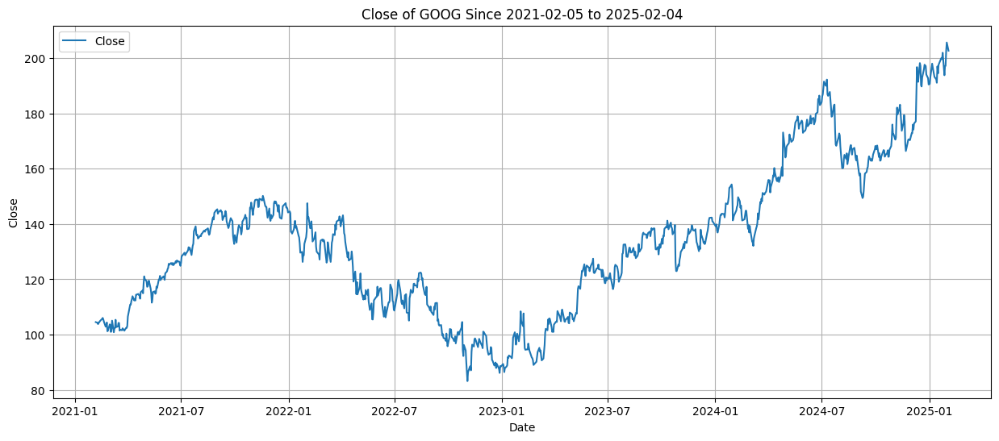

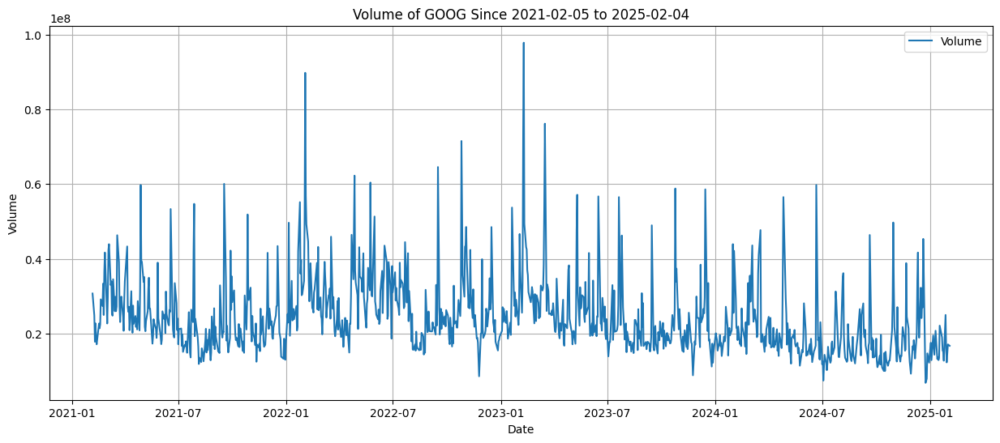

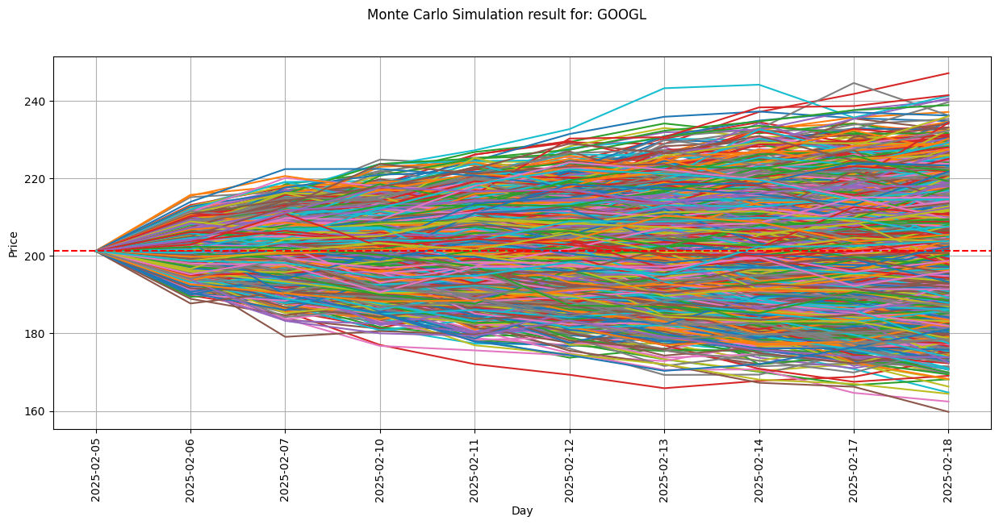

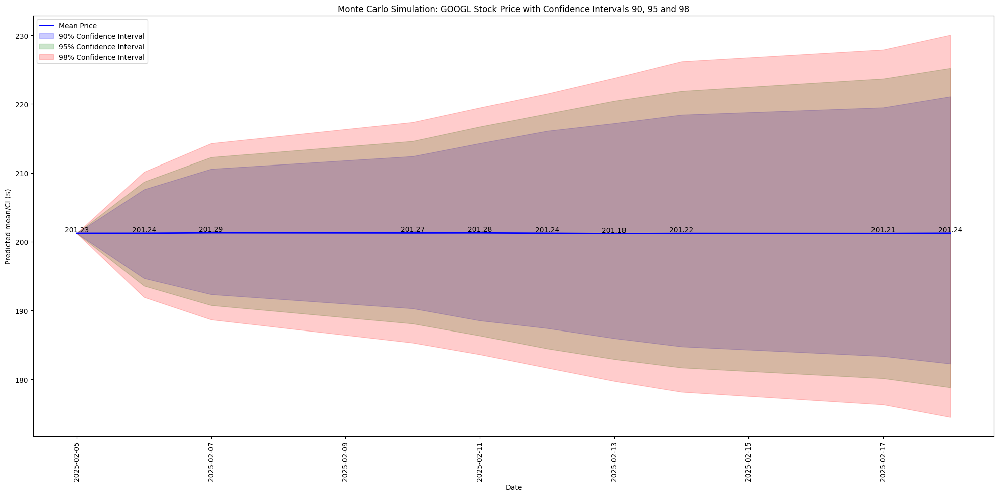

NVDA: The mean price 2025-02-05 is: 116.66, The 95% CI price: (116.66, 116.66), The 98% CI price: (116.66, 116.66)
NVDA: The mean price 2025-02-06 is: 116.59, The 95% CI price: (108.86, 124.06), The 98% CI price: (107.54, 125.72)
NVDA: The mean price 2025-02-07 is: 116.53, The 95% CI price: (105.54, 127.35), The 98% CI price: (103.79, 130.01)
NVDA: The mean price 2025-02-10 is: 116.56, The 95% CI price: (103.4, 129.99), The 98% CI price: (100.65, 132.48)
NVDA: The mean price 2025-02-11 is: 116.49, The 95% CI price: (101.61, 132.29), The 98% CI price: (99.12, 135.57)
NVDA: The mean price 2025-02-12 is: 116.51, The 95% CI price: (99.86, 134.8), The 98% CI price: (97.08, 138.36)
NVDA: The mean price 2025-02-13 is: 116.53, The 95% CI price: (98.42, 136.69), The 98% CI price: (95.77, 140.18)
NVDA: The mean price 2025-02-14 is: 116.55, The 95% CI price: (97.19, 138.03), The 98% CI price: (94.41, 143.3)
NVDA: The mean price 2025-02-17 is: 116.53, The 95% CI price: (95.52, 140.09), The 98% CI 

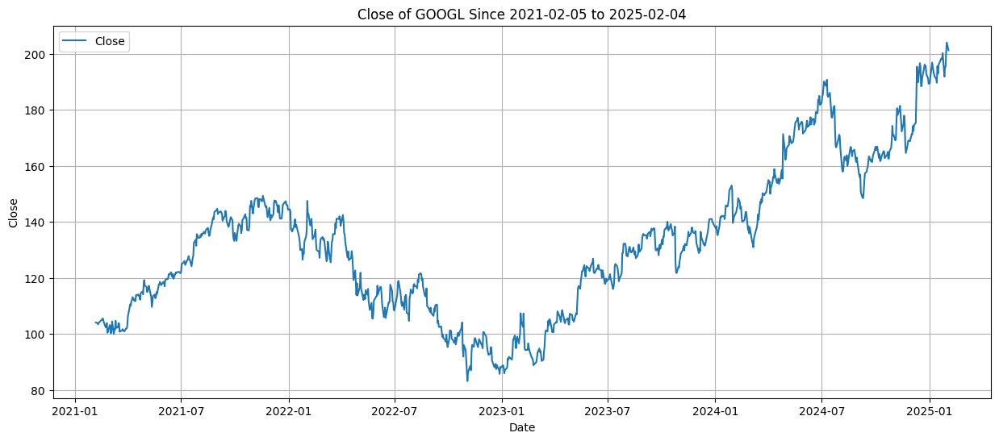

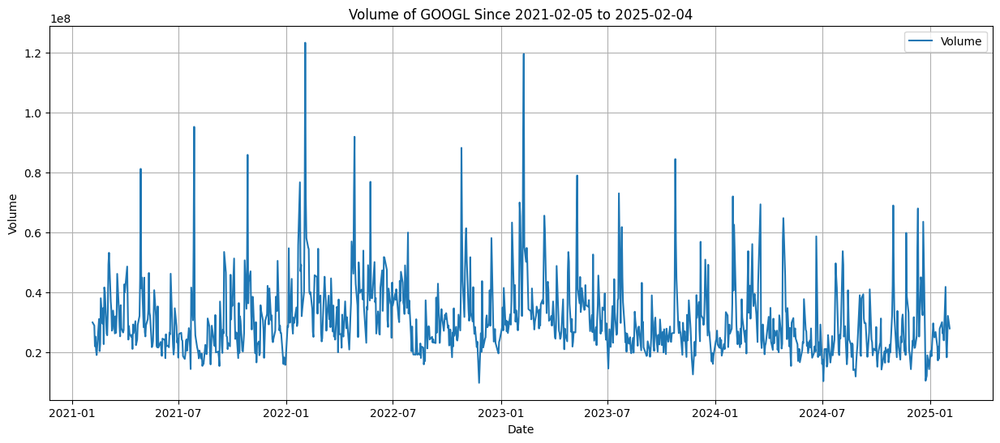

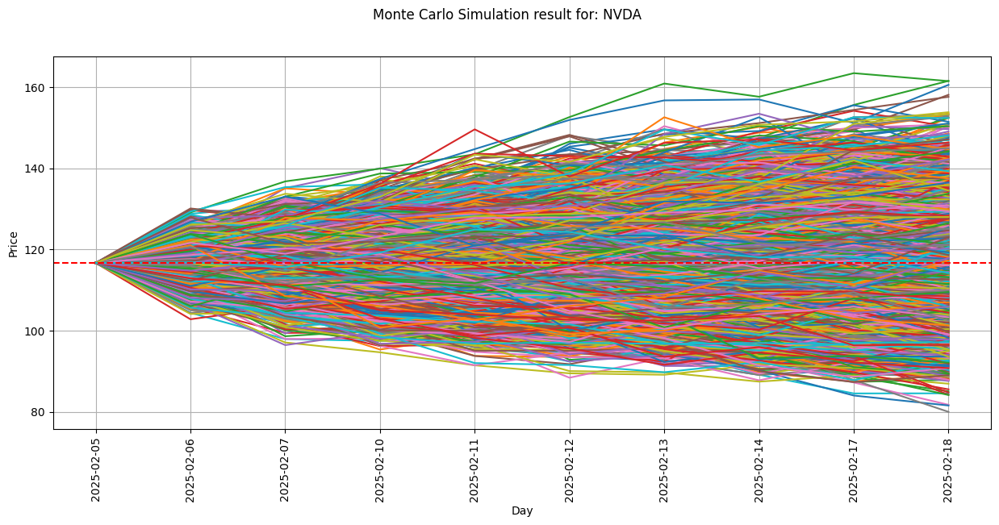

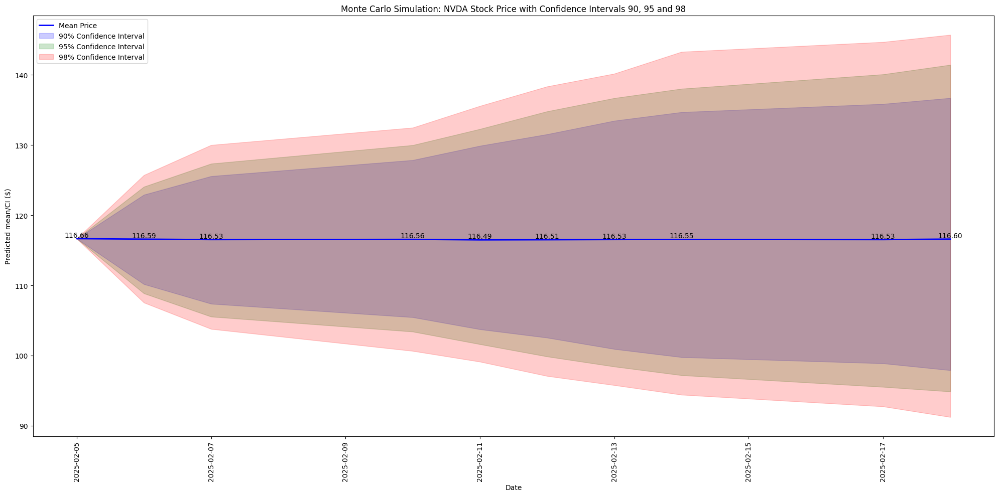

MSFT: The mean price 2025-02-05 is: 410.92, The 95% CI price: (410.92, 410.92), The 98% CI price: (410.92, 410.92)
MSFT: The mean price 2025-02-06 is: 410.86, The 95% CI price: (397.18, 424.64), The 98% CI price: (394.68, 427.03)
MSFT: The mean price 2025-02-07 is: 410.73, The 95% CI price: (392.2, 429.71), The 98% CI price: (389.29, 433.0)
MSFT: The mean price 2025-02-10 is: 410.73, The 95% CI price: (388.24, 434.15), The 98% CI price: (384.17, 438.68)
MSFT: The mean price 2025-02-11 is: 410.8, The 95% CI price: (384.62, 438.44), The 98% CI price: (380.66, 443.13)
MSFT: The mean price 2025-02-12 is: 410.7, The 95% CI price: (381.9, 441.48), The 98% CI price: (378.1, 449.04)
MSFT: The mean price 2025-02-13 is: 410.7, The 95% CI price: (379.71, 444.25), The 98% CI price: (374.53, 451.41)
MSFT: The mean price 2025-02-14 is: 410.72, The 95% CI price: (376.82, 447.16), The 98% CI price: (371.68, 455.05)
MSFT: The mean price 2025-02-17 is: 410.84, The 95% CI price: (374.51, 449.88), The 98%

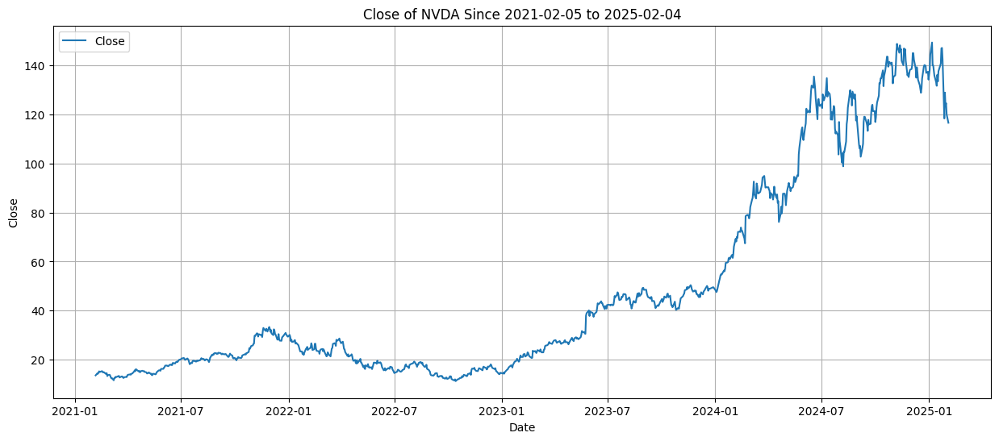

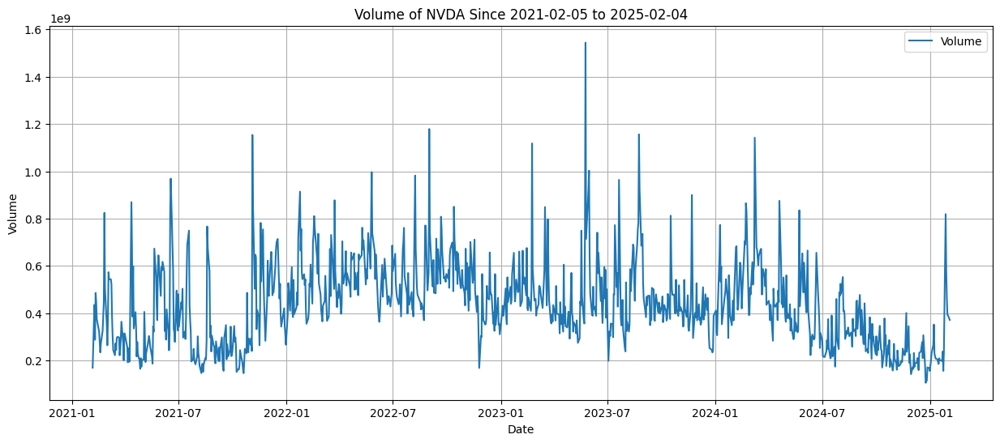

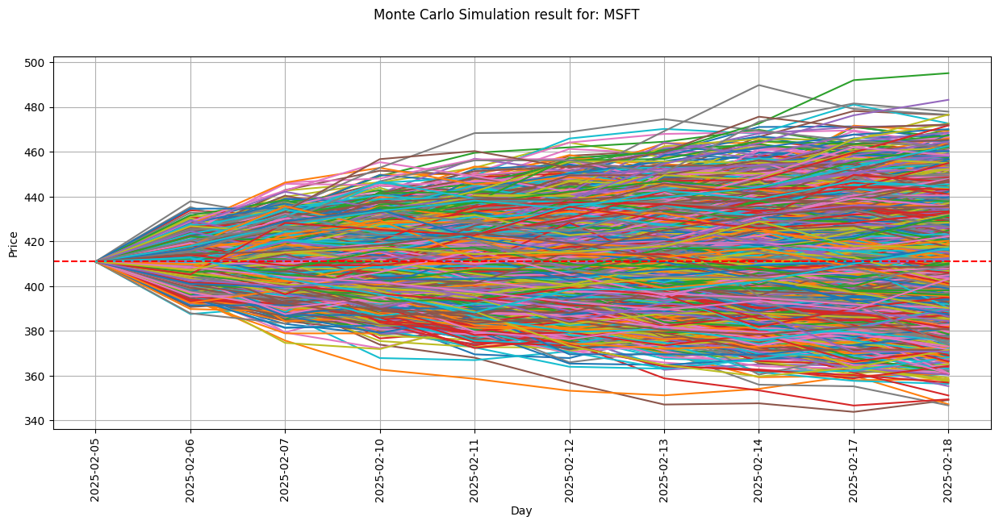

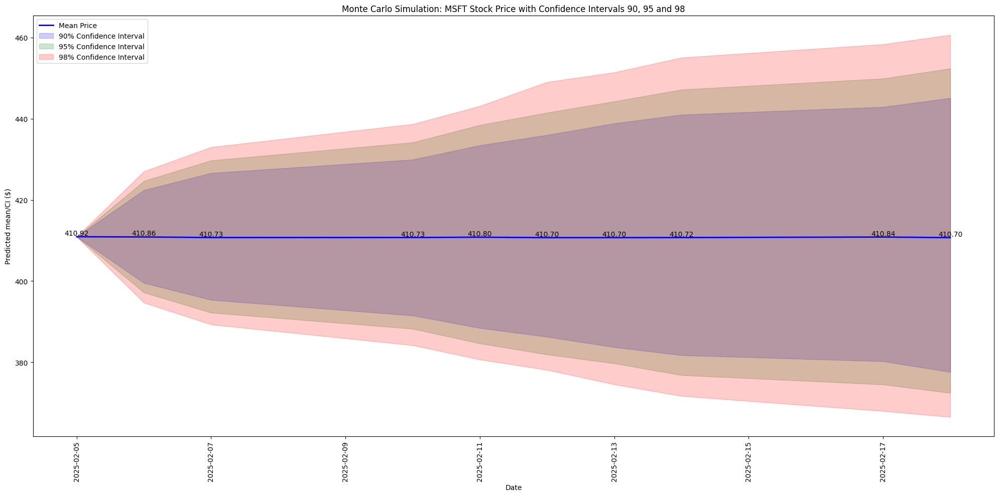

AMZN: The mean price 2025-02-05 is: 237.42, The 95% CI price: (237.42, 237.42), The 98% CI price: (237.42, 237.42)
AMZN: The mean price 2025-02-06 is: 237.49, The 95% CI price: (227.01, 247.63), The 98% CI price: (224.89, 249.33)
AMZN: The mean price 2025-02-07 is: 237.49, The 95% CI price: (223.02, 252.42), The 98% CI price: (220.13, 254.94)
AMZN: The mean price 2025-02-10 is: 237.52, The 95% CI price: (219.86, 256.03), The 98% CI price: (216.45, 260.49)
AMZN: The mean price 2025-02-11 is: 237.54, The 95% CI price: (217.43, 258.44), The 98% CI price: (214.04, 262.67)
AMZN: The mean price 2025-02-12 is: 237.68, The 95% CI price: (215.29, 261.44), The 98% CI price: (211.13, 266.59)
AMZN: The mean price 2025-02-13 is: 237.53, The 95% CI price: (212.56, 263.75), The 98% CI price: (208.81, 268.38)
AMZN: The mean price 2025-02-14 is: 237.45, The 95% CI price: (210.83, 265.57), The 98% CI price: (206.89, 270.93)
AMZN: The mean price 2025-02-17 is: 237.46, The 95% CI price: (209.13, 267.63), 

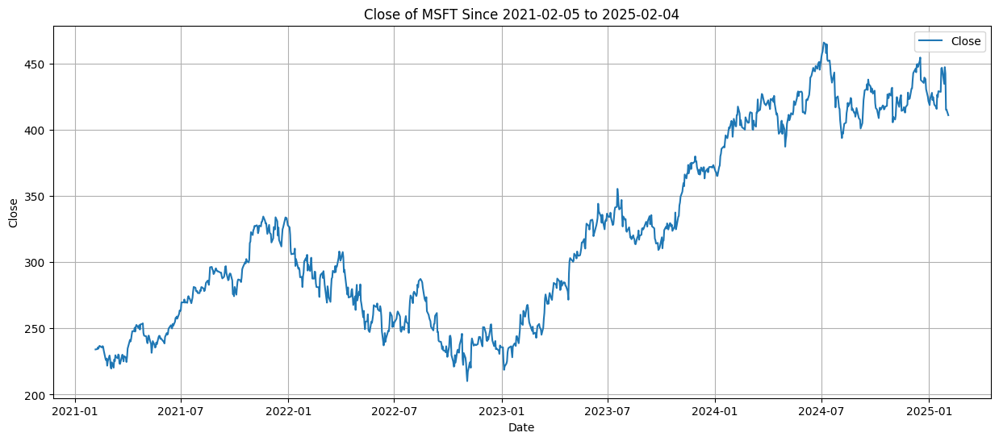

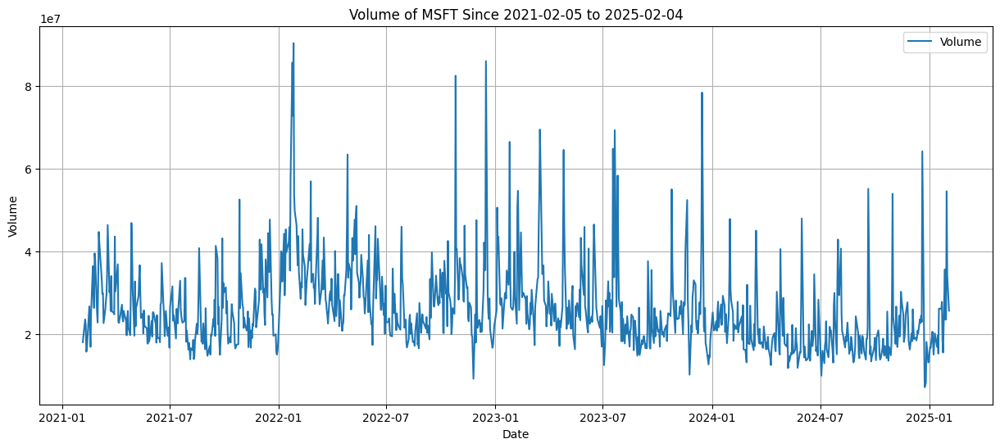

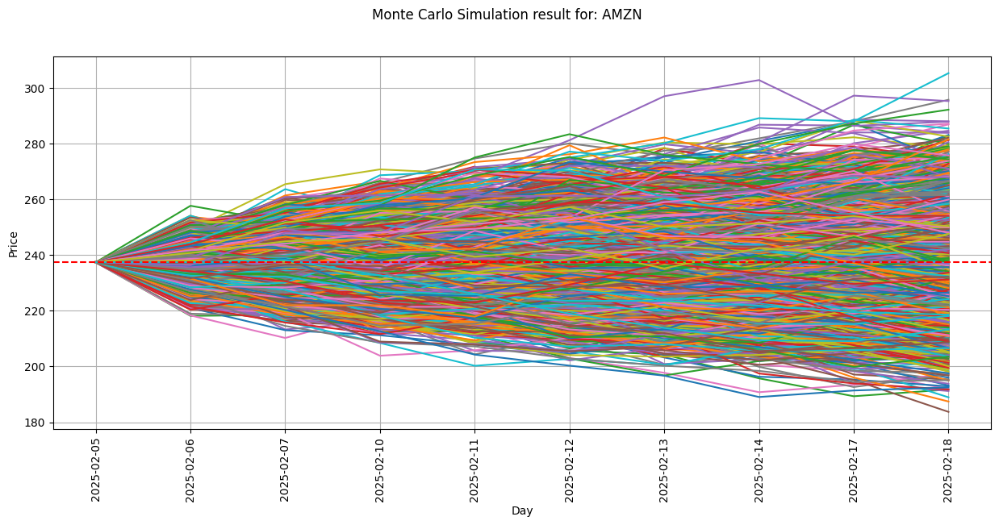

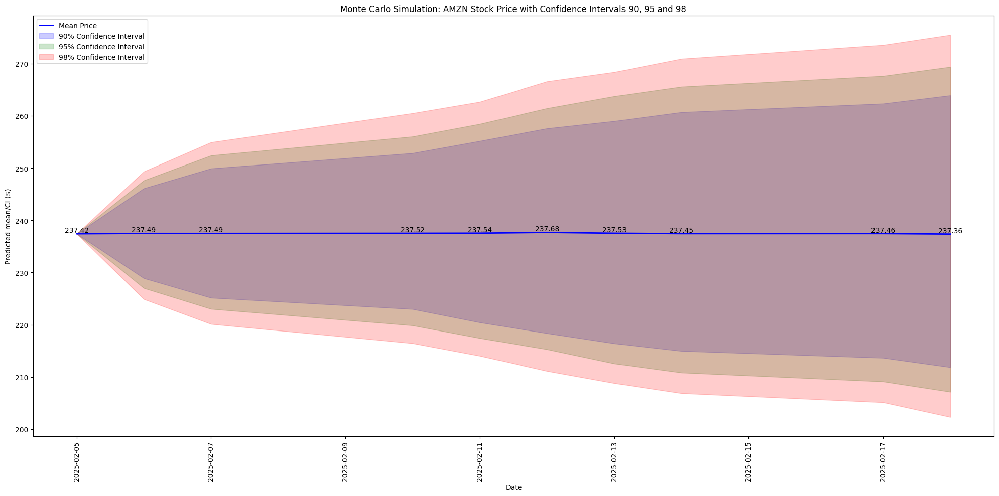

AAPL: The mean price 2025-02-05 is: 228.01, The 95% CI price: (228.01, 228.01), The 98% CI price: (228.01, 228.01)
AAPL: The mean price 2025-02-06 is: 227.92, The 95% CI price: (220.54, 235.35), The 98% CI price: (219.24, 236.78)
AAPL: The mean price 2025-02-07 is: 227.98, The 95% CI price: (217.73, 238.56), The 98% CI price: (215.64, 240.58)
AAPL: The mean price 2025-02-10 is: 227.88, The 95% CI price: (215.22, 241.18), The 98% CI price: (213.06, 243.64)
AAPL: The mean price 2025-02-11 is: 227.89, The 95% CI price: (213.56, 242.72), The 98% CI price: (210.81, 245.76)
AAPL: The mean price 2025-02-12 is: 227.8, The 95% CI price: (211.66, 244.88), The 98% CI price: (209.2, 247.86)
AAPL: The mean price 2025-02-13 is: 227.83, The 95% CI price: (210.82, 246.46), The 98% CI price: (207.2, 250.46)
AAPL: The mean price 2025-02-14 is: 227.84, The 95% CI price: (209.39, 247.86), The 98% CI price: (206.16, 252.26)
AAPL: The mean price 2025-02-17 is: 227.83, The 95% CI price: (208.22, 249.42), The

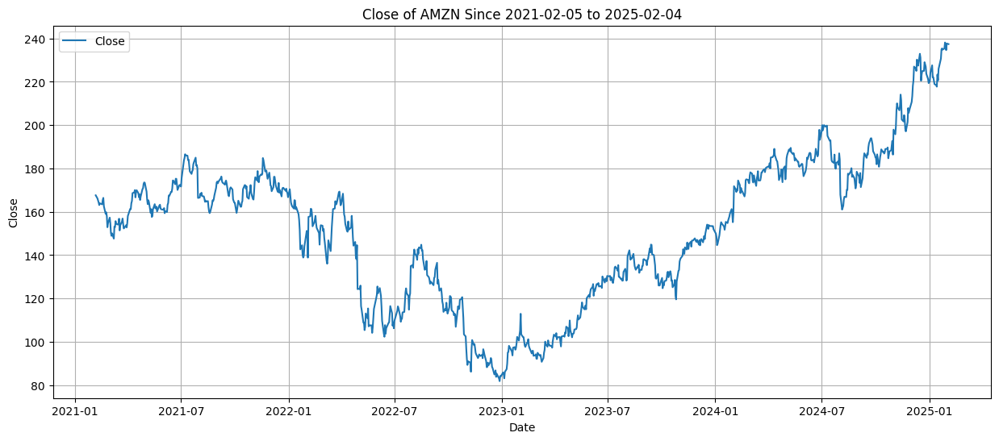

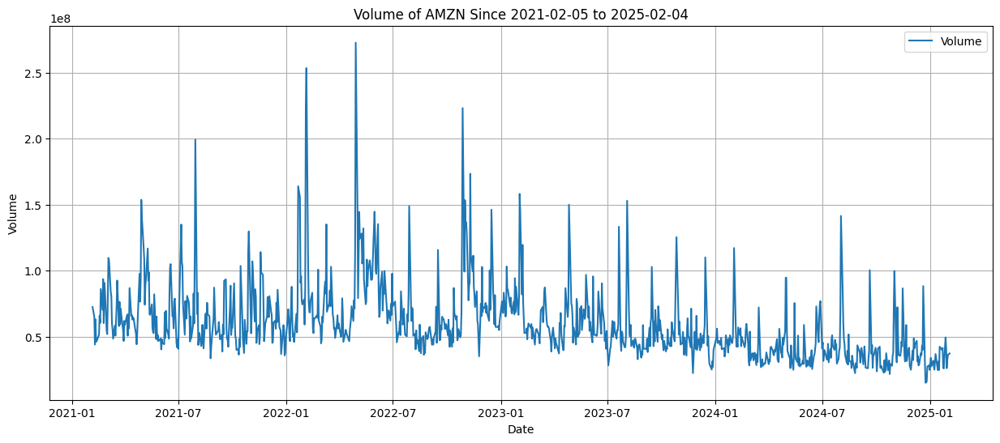

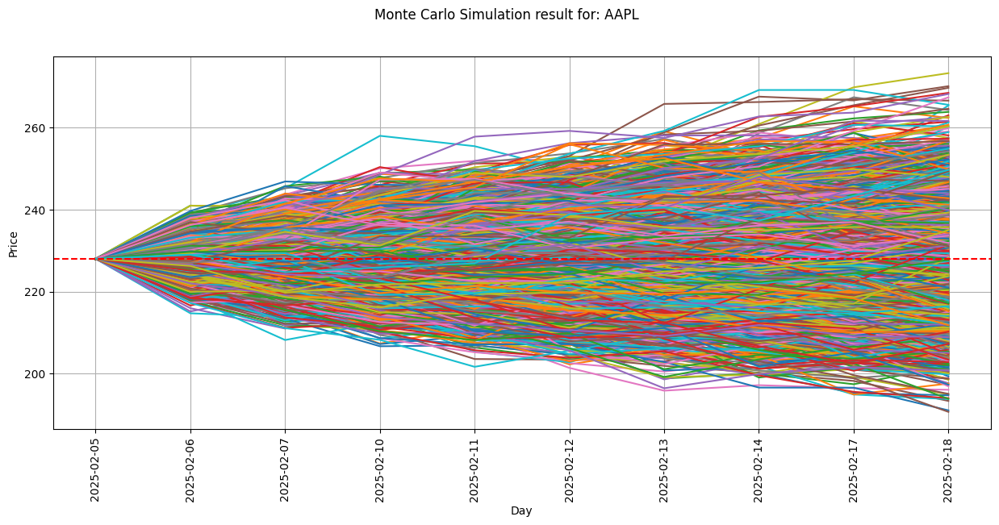

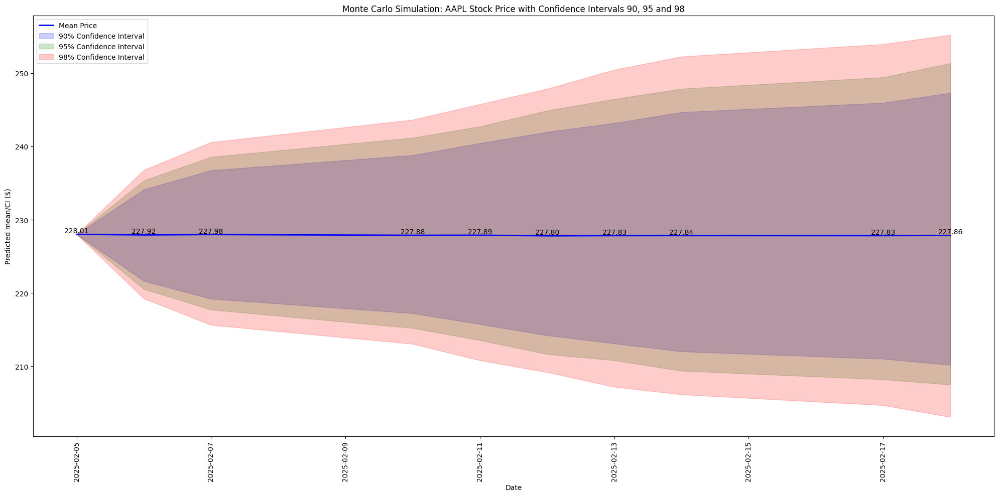

INTC: The mean price 2025-02-05 is: 19.38, The 95% CI price: (19.38, 19.38), The 98% CI price: (19.38, 19.38)
INTC: The mean price 2025-02-06 is: 19.39, The 95% CI price: (18.41, 20.39), The 98% CI price: (18.26, 20.62)
INTC: The mean price 2025-02-07 is: 19.38, The 95% CI price: (18.01, 20.87), The 98% CI price: (17.76, 21.16)
INTC: The mean price 2025-02-10 is: 19.39, The 95% CI price: (17.73, 21.2), The 98% CI price: (17.42, 21.59)
INTC: The mean price 2025-02-11 is: 19.39, The 95% CI price: (17.49, 21.41), The 98% CI price: (17.08, 21.88)
INTC: The mean price 2025-02-12 is: 19.38, The 95% CI price: (17.22, 21.67), The 98% CI price: (16.86, 22.08)
INTC: The mean price 2025-02-13 is: 19.38, The 95% CI price: (17.05, 21.87), The 98% CI price: (16.72, 22.41)
INTC: The mean price 2025-02-14 is: 19.38, The 95% CI price: (16.9, 22.07), The 98% CI price: (16.41, 22.63)
INTC: The mean price 2025-02-17 is: 19.39, The 95% CI price: (16.7, 22.24), The 98% CI price: (16.26, 22.85)
INTC: The mea

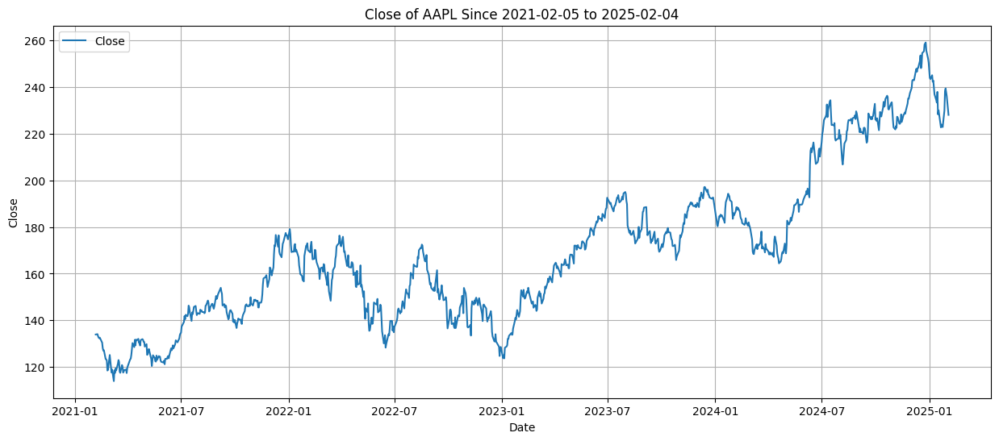

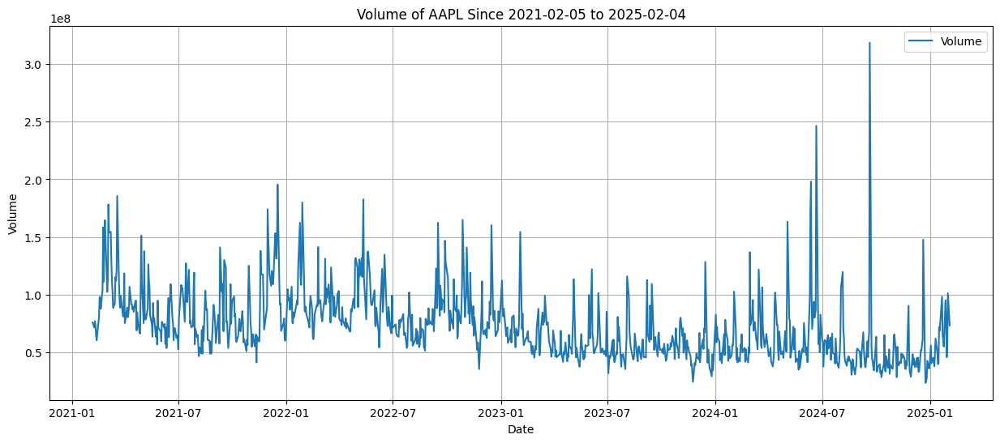

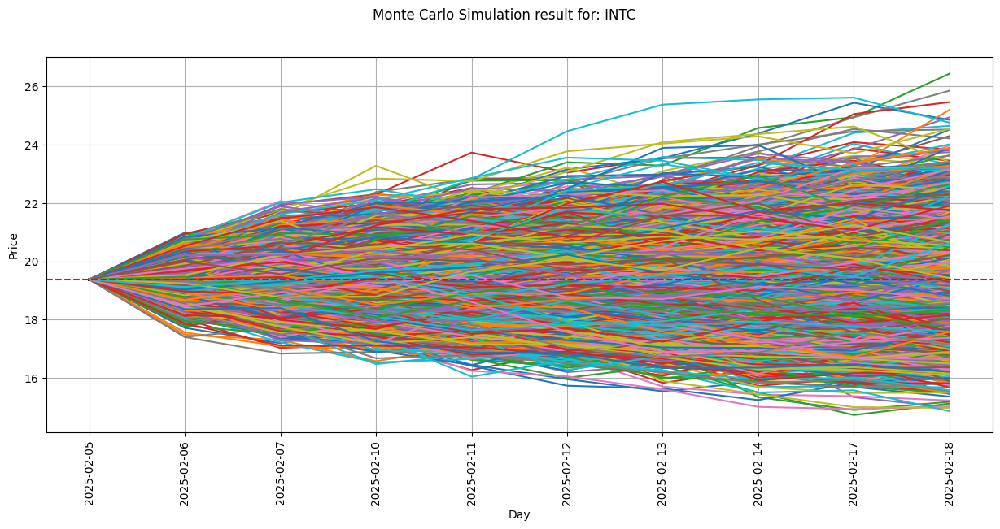

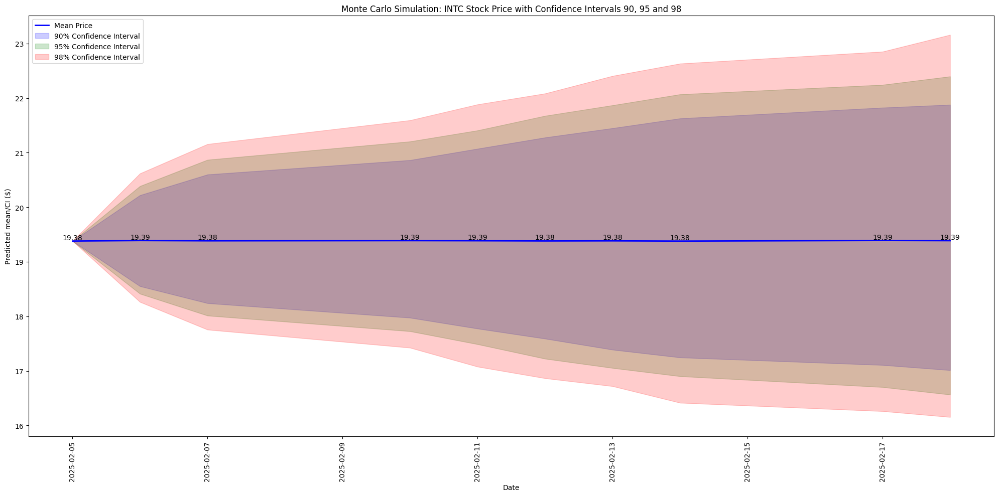

META: The mean price 2025-02-05 is: 697.46, The 95% CI price: (697.46, 697.46), The 98% CI price: (697.46, 697.46)
META: The mean price 2025-02-06 is: 697.38, The 95% CI price: (659.43, 736.43), The 98% CI price: (650.44, 744.18)
META: The mean price 2025-02-07 is: 697.64, The 95% CI price: (644.76, 753.56), The 98% CI price: (635.53, 763.04)
META: The mean price 2025-02-10 is: 697.78, The 95% CI price: (631.85, 766.8), The 98% CI price: (619.78, 780.46)
META: The mean price 2025-02-11 is: 697.9, The 95% CI price: (623.62, 778.76), The 98% CI price: (612.24, 792.72)
META: The mean price 2025-02-12 is: 697.89, The 95% CI price: (612.79, 790.7), The 98% CI price: (601.18, 808.99)
META: The mean price 2025-02-13 is: 697.25, The 95% CI price: (604.87, 799.09), The 98% CI price: (590.66, 822.21)
META: The mean price 2025-02-14 is: 696.75, The 95% CI price: (597.55, 808.59), The 98% CI price: (580.06, 829.32)
META: The mean price 2025-02-17 is: 696.19, The 95% CI price: (591.0, 817.52), The 

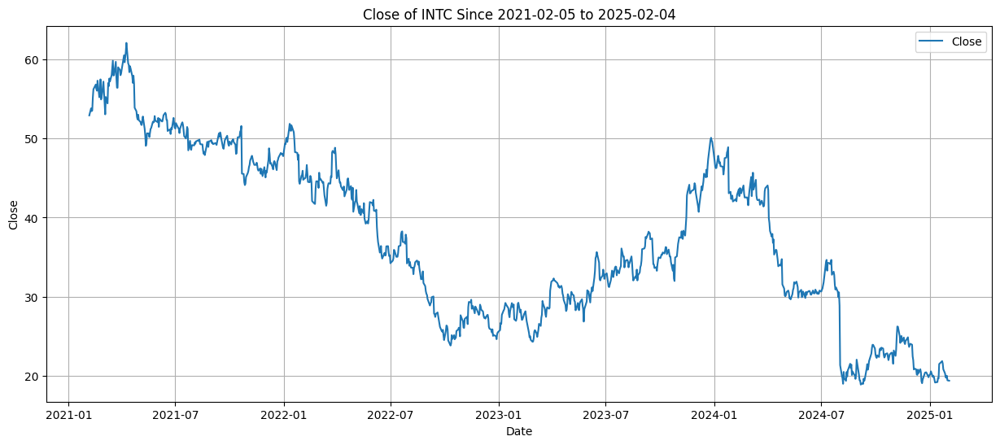

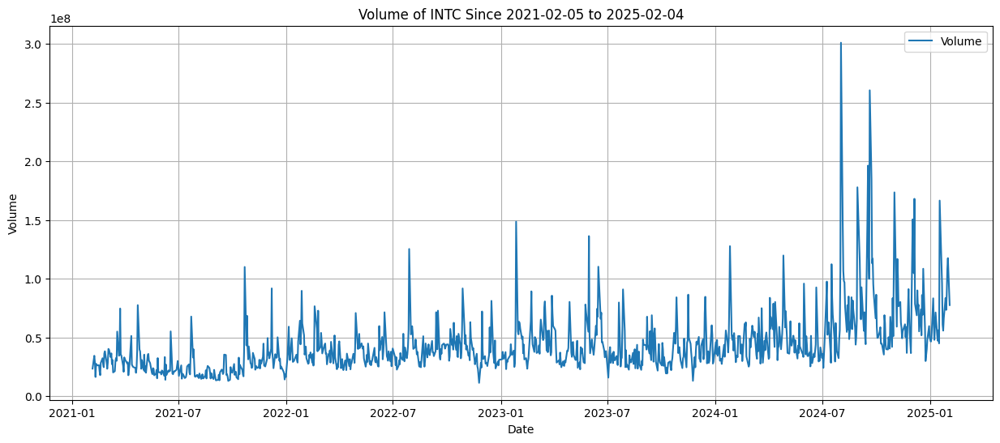

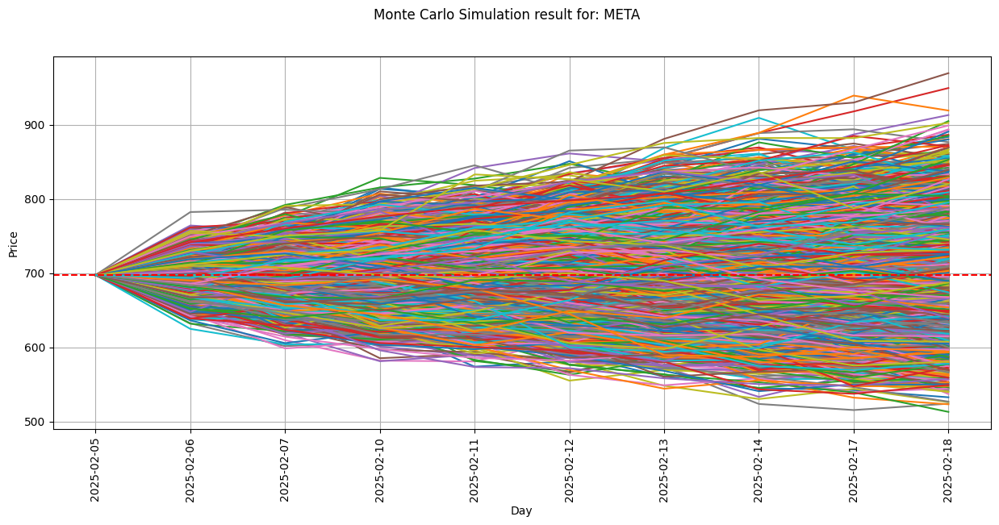

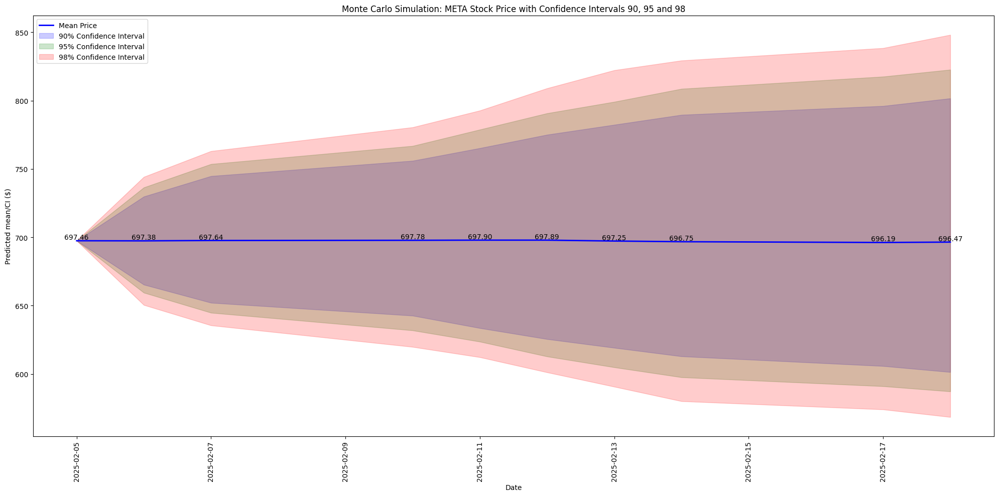

AMD: The mean price 2025-02-05 is: 114.27, The 95% CI price: (114.27, 114.27), The 98% CI price: (114.27, 114.27)
AMD: The mean price 2025-02-06 is: 114.18, The 95% CI price: (106.95, 121.07), The 98% CI price: (105.84, 122.21)
AMD: The mean price 2025-02-07 is: 114.26, The 95% CI price: (104.62, 124.2), The 98% CI price: (102.58, 126.31)
AMD: The mean price 2025-02-10 is: 114.3, The 95% CI price: (102.55, 126.63), The 98% CI price: (100.07, 129.21)
AMD: The mean price 2025-02-11 is: 114.3, The 95% CI price: (100.69, 128.82), The 98% CI price: (97.97, 131.77)
AMD: The mean price 2025-02-12 is: 114.36, The 95% CI price: (99.15, 131.1), The 98% CI price: (96.76, 133.83)
AMD: The mean price 2025-02-13 is: 114.34, The 95% CI price: (97.94, 132.0), The 98% CI price: (95.45, 135.93)
AMD: The mean price 2025-02-14 is: 114.3, The 95% CI price: (96.3, 133.6), The 98% CI price: (93.53, 138.56)
AMD: The mean price 2025-02-17 is: 114.25, The 95% CI price: (95.29, 135.7), The 98% CI price: (91.6, 1

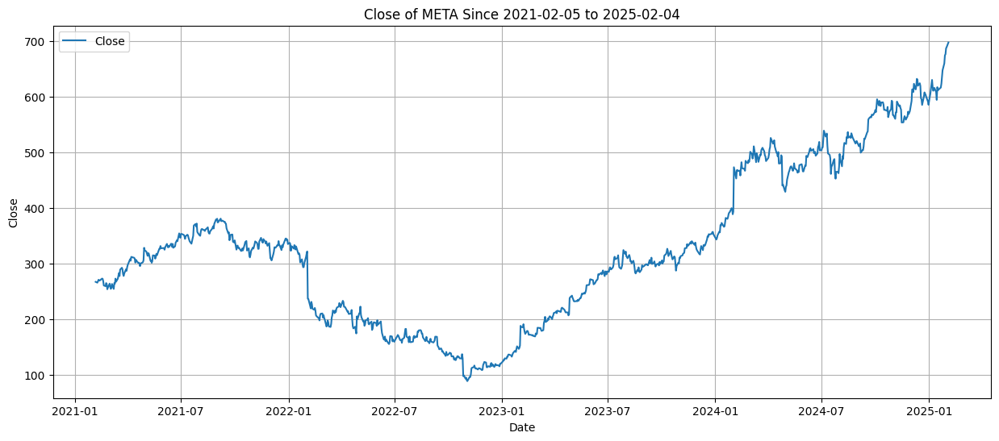

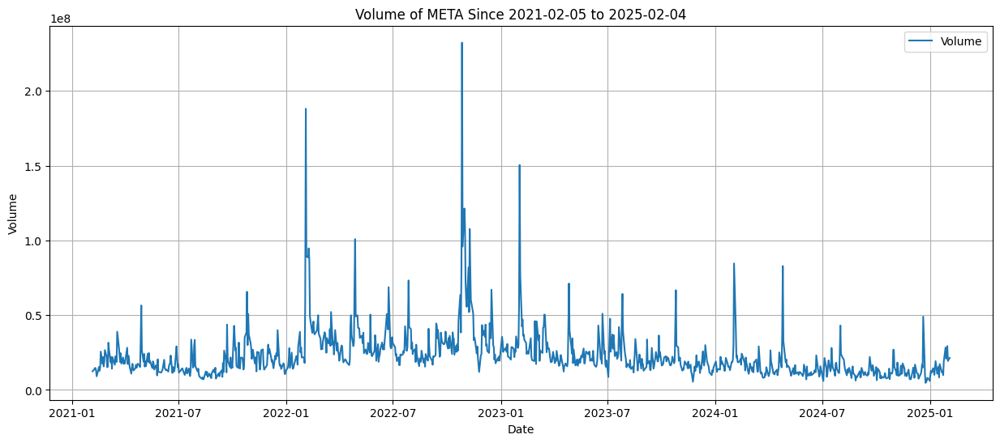

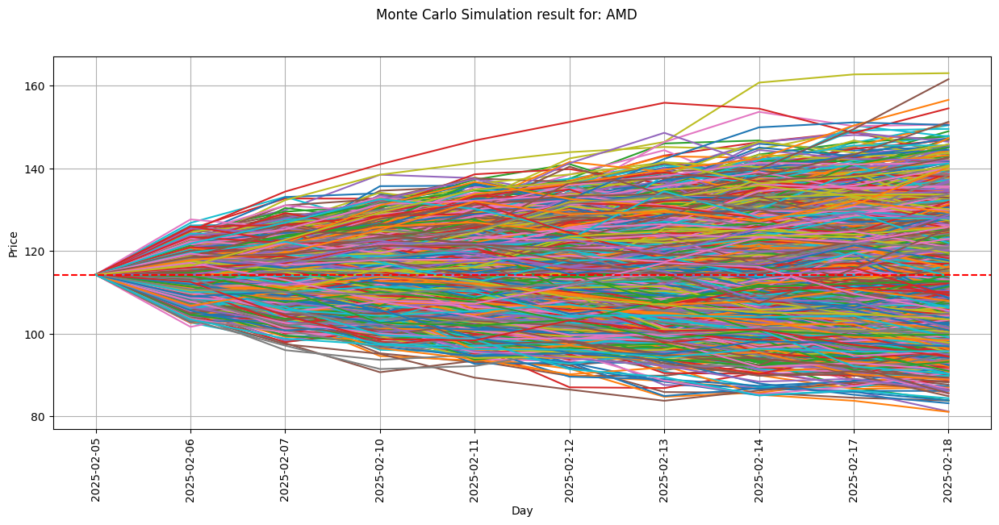

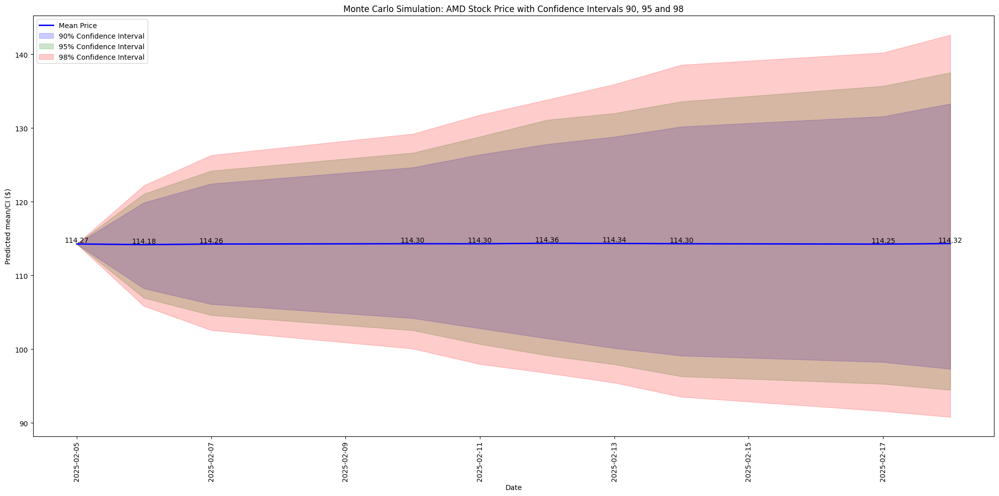

BA: The mean price 2025-02-05 is: 175.87, The 95% CI price: (175.87, 175.87), The 98% CI price: (175.87, 175.87)
BA: The mean price 2025-02-06 is: 175.84, The 95% CI price: (168.0, 183.8), The 98% CI price: (166.67, 185.32)
BA: The mean price 2025-02-07 is: 175.8, The 95% CI price: (164.82, 187.13), The 98% CI price: (162.64, 189.11)
BA: The mean price 2025-02-10 is: 175.79, The 95% CI price: (162.65, 190.05), The 98% CI price: (160.16, 192.59)
BA: The mean price 2025-02-11 is: 175.78, The 95% CI price: (160.43, 192.46), The 98% CI price: (157.74, 196.03)
BA: The mean price 2025-02-12 is: 175.71, The 95% CI price: (158.71, 194.52), The 98% CI price: (156.61, 198.07)
BA: The mean price 2025-02-13 is: 175.74, The 95% CI price: (157.07, 196.46), The 98% CI price: (153.84, 200.48)
BA: The mean price 2025-02-14 is: 175.67, The 95% CI price: (155.34, 197.0), The 98% CI price: (152.59, 202.58)
BA: The mean price 2025-02-17 is: 175.67, The 95% CI price: (154.53, 198.64), The 98% CI price: (151

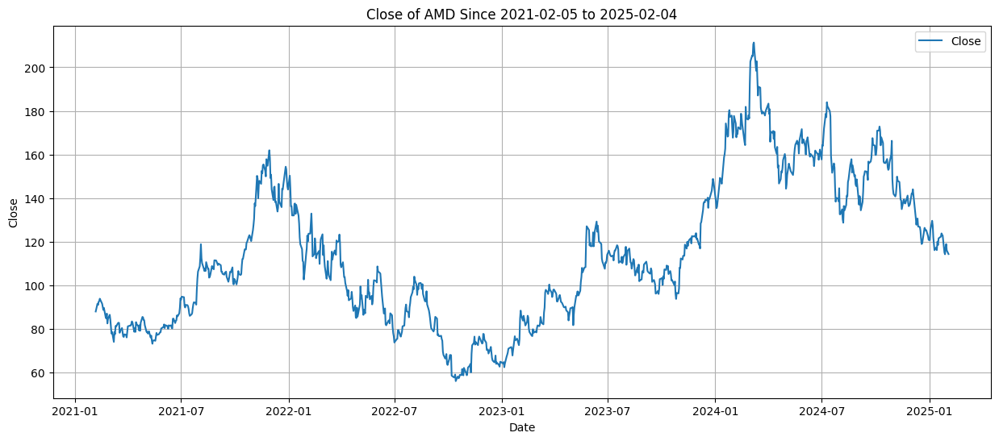

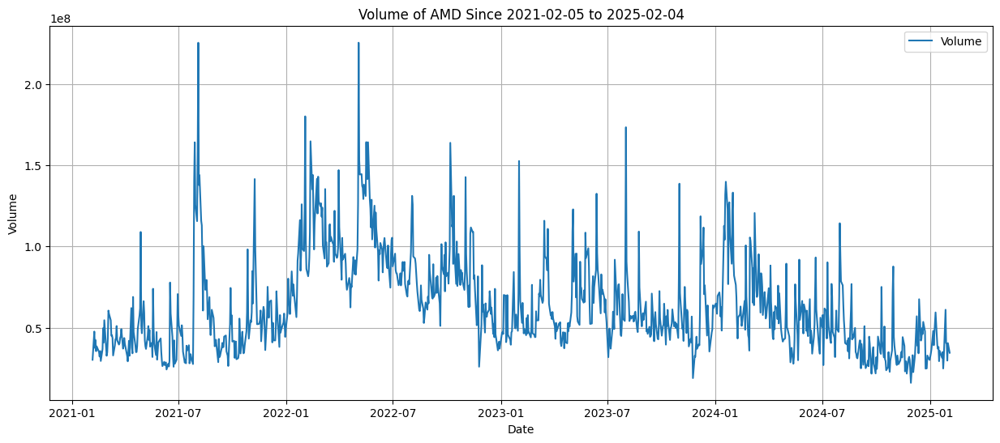

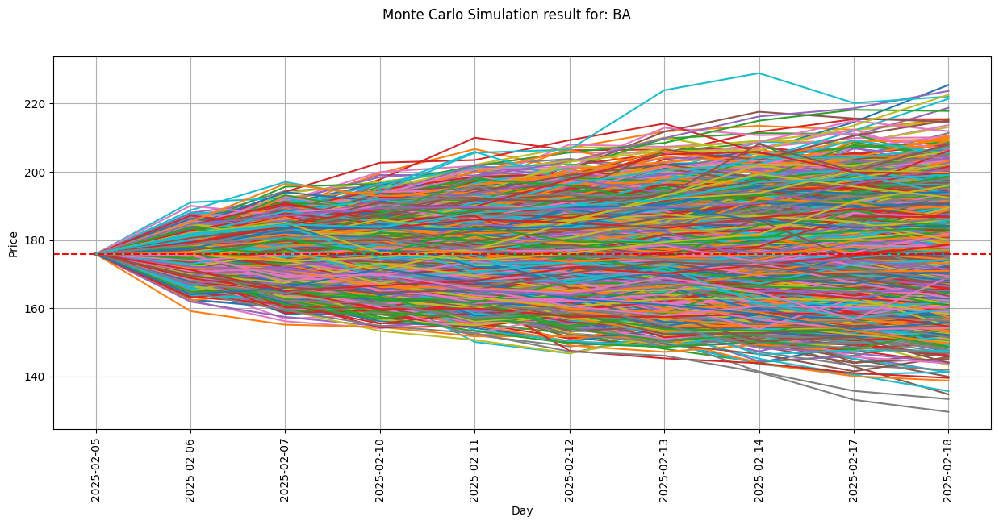

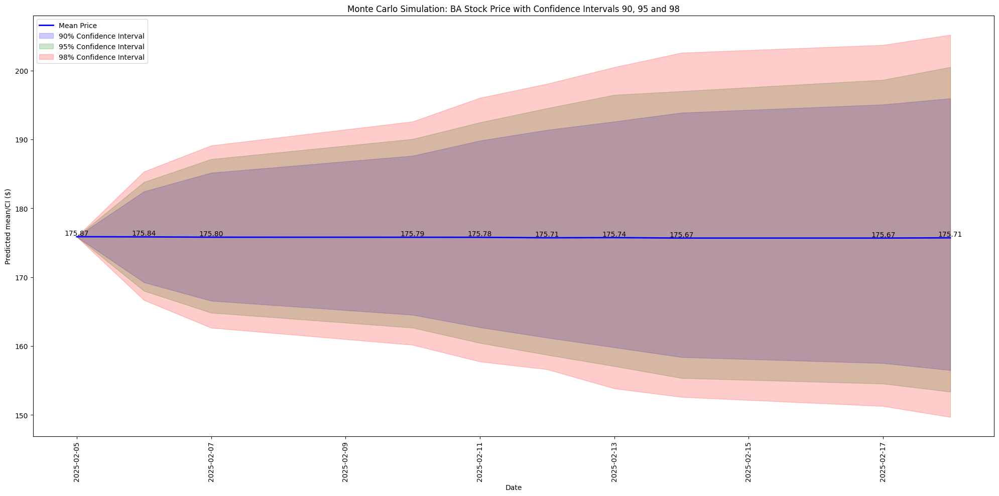

TSLA: The mean price 2025-02-05 is: 383.68, The 95% CI price: (383.68, 383.68), The 98% CI price: (383.68, 383.68)
TSLA: The mean price 2025-02-06 is: 383.68, The 95% CI price: (355.86, 411.95), The 98% CI price: (350.55, 416.38)
TSLA: The mean price 2025-02-07 is: 383.46, The 95% CI price: (344.17, 423.44), The 98% CI price: (337.5, 430.76)
TSLA: The mean price 2025-02-10 is: 383.47, The 95% CI price: (335.97, 433.55), The 98% CI price: (327.2, 442.4)
TSLA: The mean price 2025-02-11 is: 383.48, The 95% CI price: (329.95, 442.04), The 98% CI price: (320.89, 454.01)
TSLA: The mean price 2025-02-12 is: 383.34, The 95% CI price: (322.83, 449.18), The 98% CI price: (313.78, 463.28)
TSLA: The mean price 2025-02-13 is: 383.14, The 95% CI price: (317.88, 454.96), The 98% CI price: (307.39, 468.83)
TSLA: The mean price 2025-02-14 is: 383.1, The 95% CI price: (312.49, 463.5), The 98% CI price: (301.01, 478.62)
TSLA: The mean price 2025-02-17 is: 382.87, The 95% CI price: (309.25, 468.63), The 9

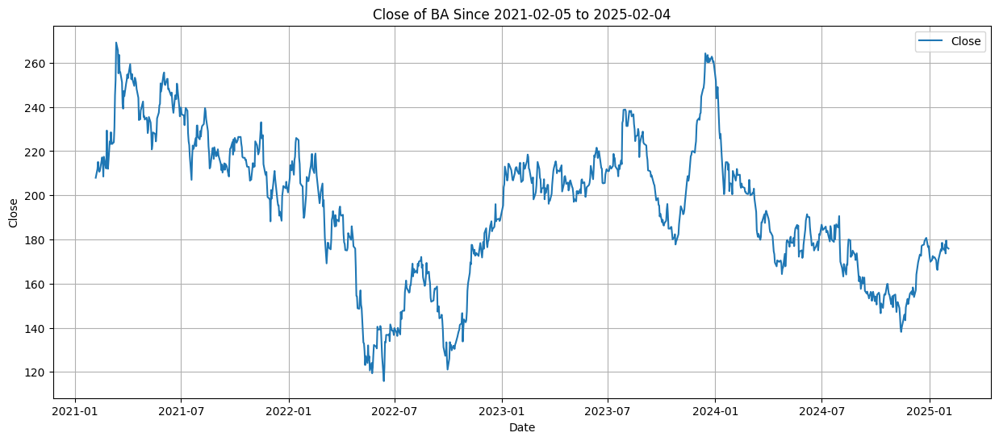

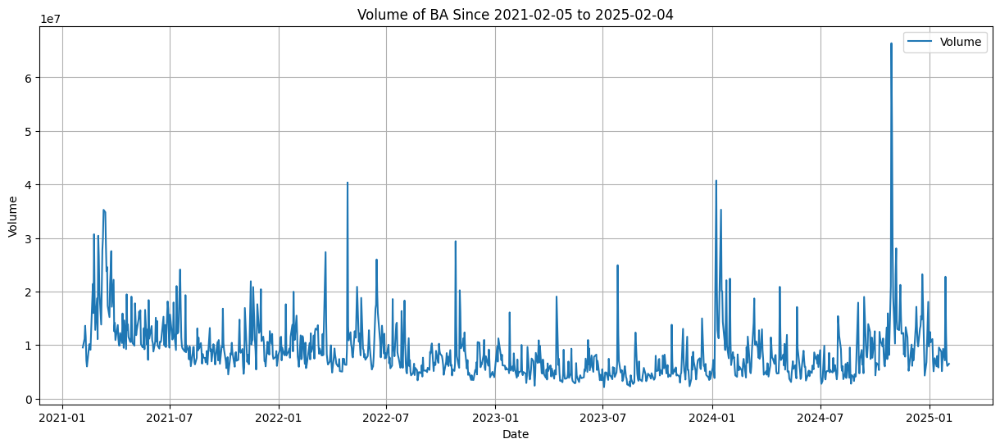

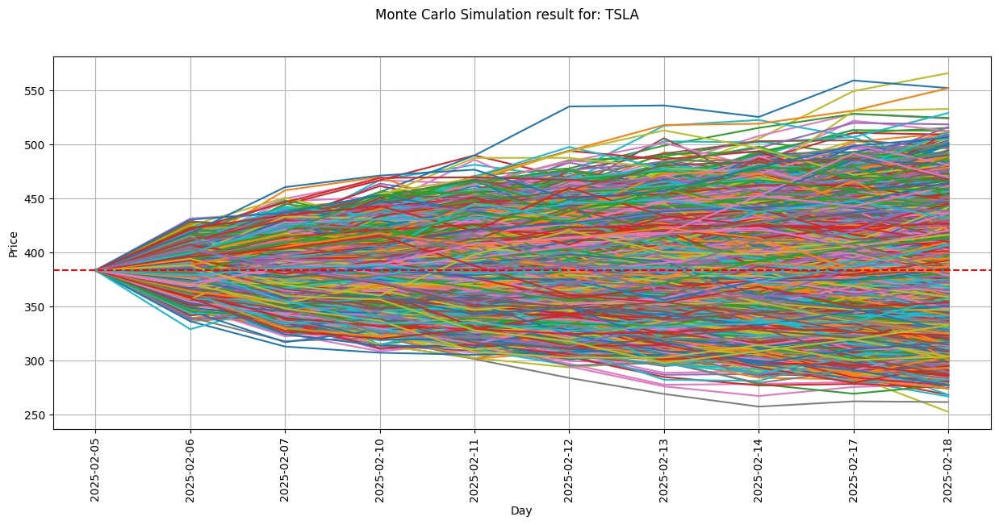

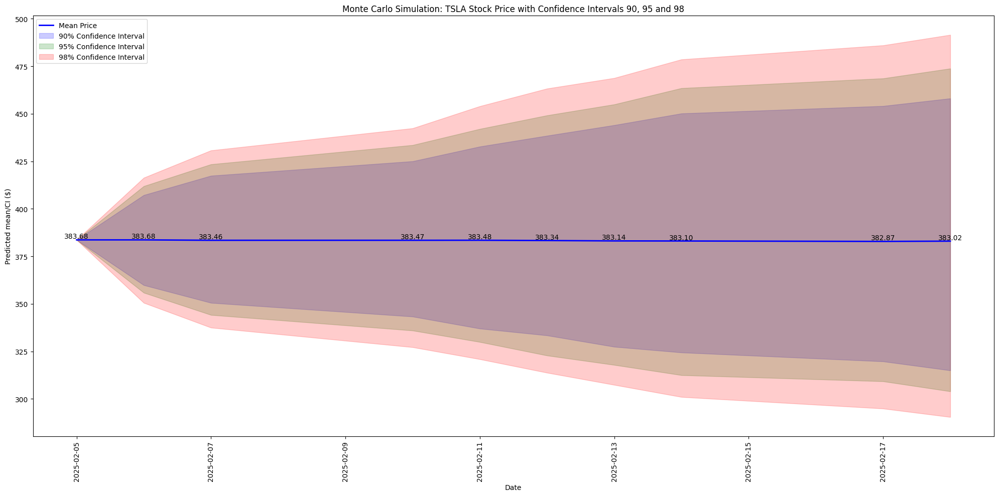

ORCL: The mean price 2025-02-05 is: 168.6, The 95% CI price: (168.6, 168.6), The 98% CI price: (168.6, 168.6)
ORCL: The mean price 2025-02-06 is: 168.56, The 95% CI price: (161.78, 175.44), The 98% CI price: (160.6, 176.56)
ORCL: The mean price 2025-02-07 is: 168.53, The 95% CI price: (159.06, 178.17), The 98% CI price: (157.28, 180.16)
ORCL: The mean price 2025-02-10 is: 168.46, The 95% CI price: (156.95, 180.51), The 98% CI price: (154.83, 182.45)
ORCL: The mean price 2025-02-11 is: 168.4, The 95% CI price: (155.27, 182.27), The 98% CI price: (153.45, 184.88)
ORCL: The mean price 2025-02-12 is: 168.36, The 95% CI price: (154.1, 184.19), The 98% CI price: (151.56, 187.0)
ORCL: The mean price 2025-02-13 is: 168.37, The 95% CI price: (152.79, 185.71), The 98% CI price: (149.95, 189.12)
ORCL: The mean price 2025-02-14 is: 168.47, The 95% CI price: (151.5, 187.19), The 98% CI price: (147.71, 191.14)
ORCL: The mean price 2025-02-17 is: 168.53, The 95% CI price: (150.25, 188.39), The 98% CI

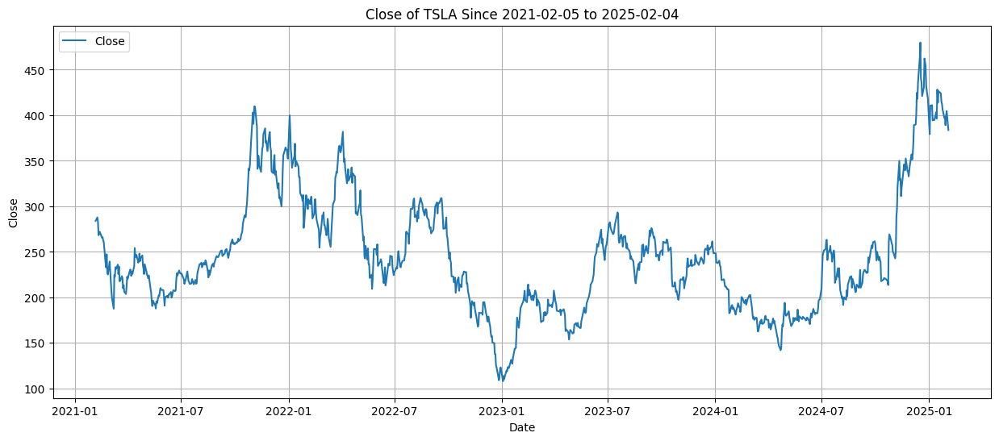

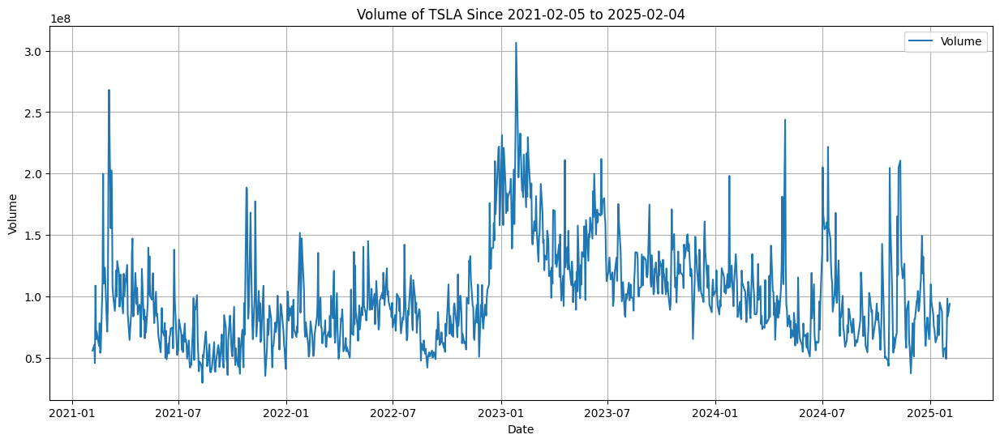

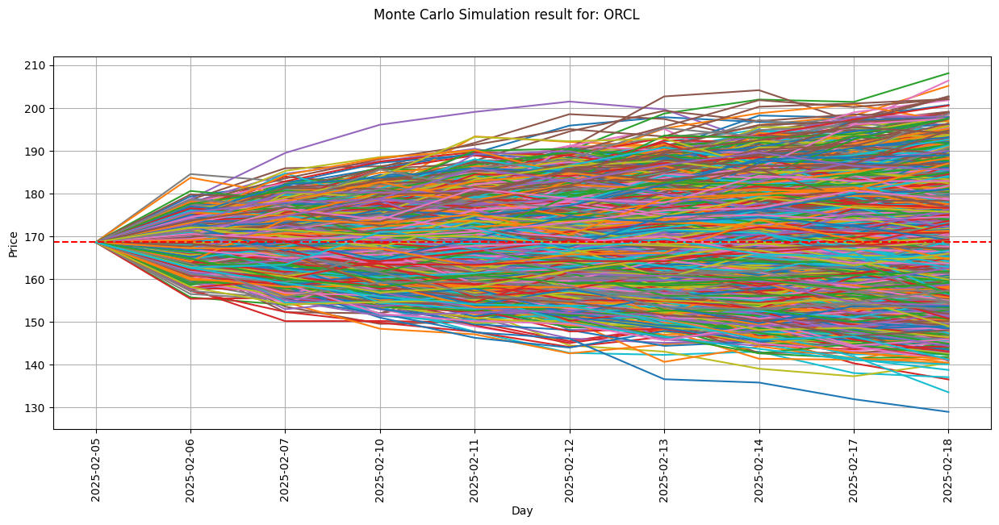

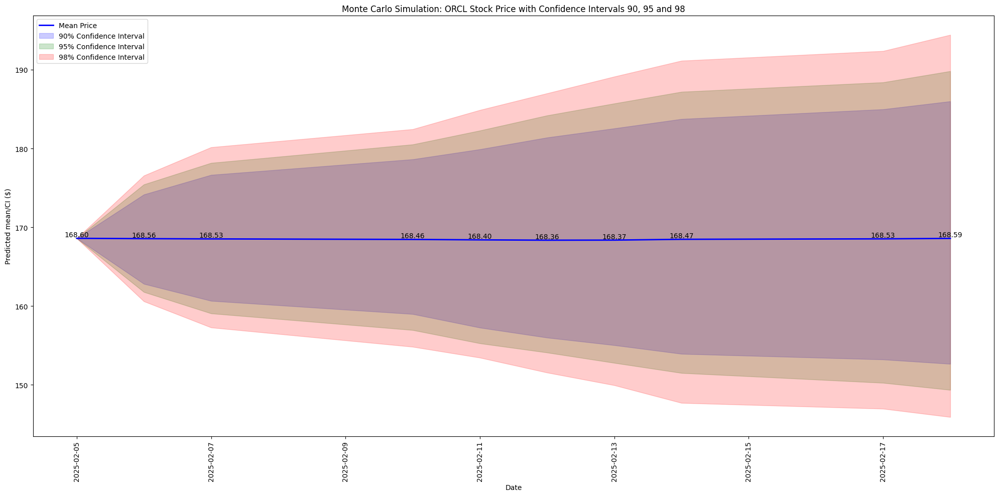

CRM: The mean price 2025-02-05 is: 339.24, The 95% CI price: (339.24, 339.24), The 98% CI price: (339.24, 339.24)
CRM: The mean price 2025-02-06 is: 339.11, The 95% CI price: (324.03, 354.0), The 98% CI price: (321.29, 357.28)
CRM: The mean price 2025-02-07 is: 339.05, The 95% CI price: (318.04, 360.81), The 98% CI price: (314.08, 364.39)
CRM: The mean price 2025-02-10 is: 338.78, The 95% CI price: (313.14, 365.32), The 98% CI price: (307.81, 370.24)
CRM: The mean price 2025-02-11 is: 338.72, The 95% CI price: (308.85, 369.9), The 98% CI price: (303.61, 375.86)
CRM: The mean price 2025-02-12 is: 338.88, The 95% CI price: (306.16, 374.33), The 98% CI price: (299.49, 381.01)
CRM: The mean price 2025-02-13 is: 339.03, The 95% CI price: (302.81, 377.5), The 98% CI price: (296.45, 385.24)
CRM: The mean price 2025-02-14 is: 339.0, The 95% CI price: (300.36, 380.33), The 98% CI price: (293.5, 389.11)
CRM: The mean price 2025-02-17 is: 339.13, The 95% CI price: (298.2, 382.91), The 98% CI pric

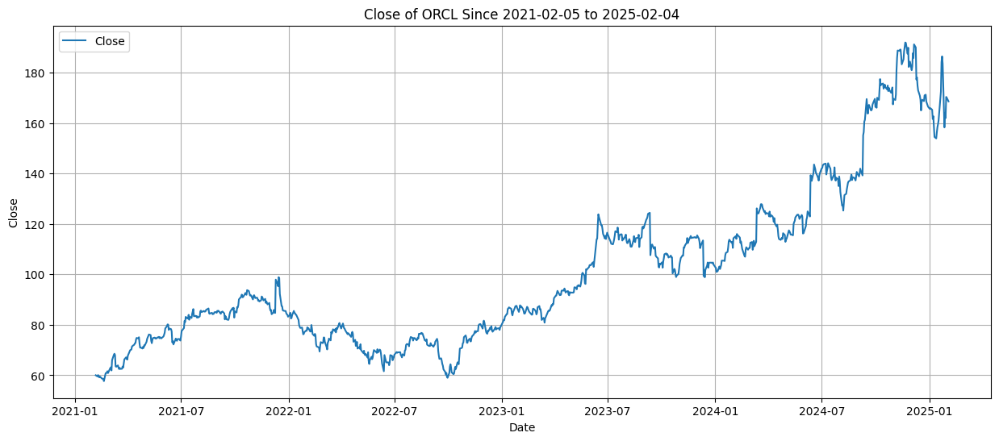

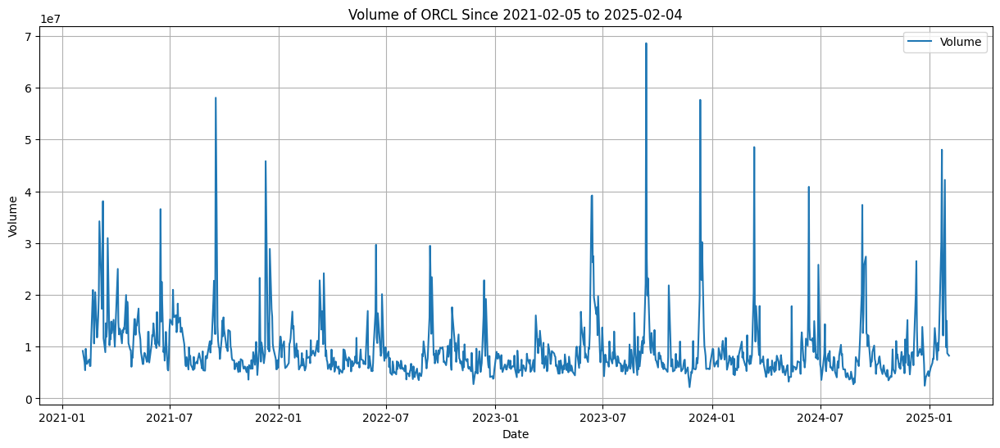

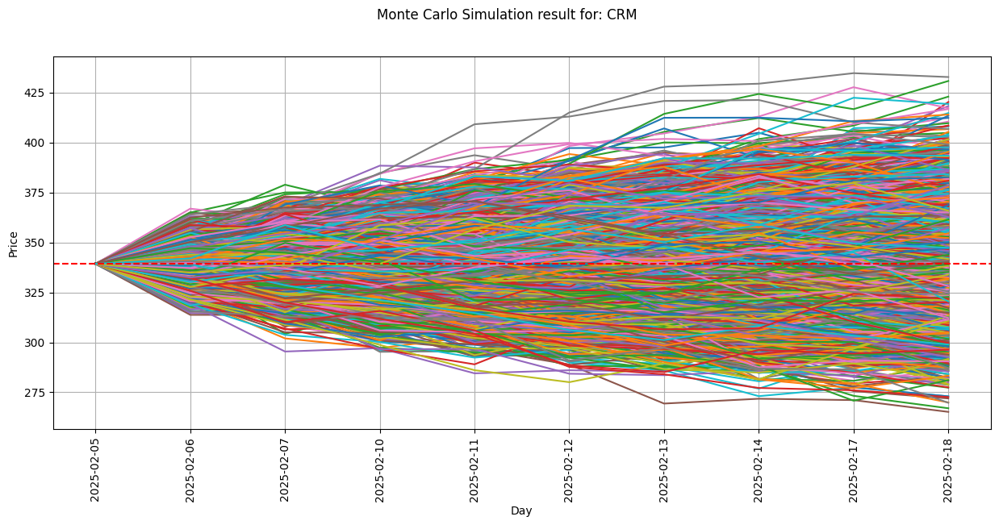

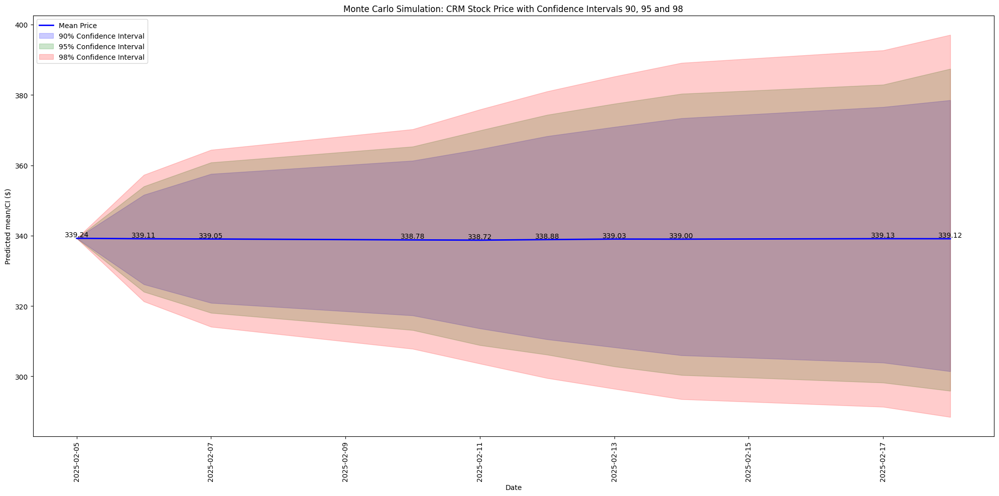

IBM: The mean price 2025-02-05 is: 260.73, The 95% CI price: (260.73, 260.73), The 98% CI price: (260.73, 260.73)
IBM: The mean price 2025-02-06 is: 260.73, The 95% CI price: (253.61, 267.91), The 98% CI price: (252.42, 269.28)
IBM: The mean price 2025-02-07 is: 260.8, The 95% CI price: (251.06, 270.71), The 98% CI price: (249.27, 272.52)
IBM: The mean price 2025-02-10 is: 260.83, The 95% CI price: (249.03, 273.09), The 98% CI price: (246.63, 275.85)
IBM: The mean price 2025-02-11 is: 260.82, The 95% CI price: (246.68, 275.33), The 98% CI price: (244.28, 278.65)
IBM: The mean price 2025-02-12 is: 260.84, The 95% CI price: (245.25, 277.14), The 98% CI price: (242.76, 280.84)
IBM: The mean price 2025-02-13 is: 260.9, The 95% CI price: (243.96, 278.39), The 98% CI price: (240.36, 282.79)
IBM: The mean price 2025-02-14 is: 260.92, The 95% CI price: (242.26, 280.52), The 98% CI price: (239.28, 284.54)
IBM: The mean price 2025-02-17 is: 260.98, The 95% CI price: (240.83, 282.33), The 98% CI 

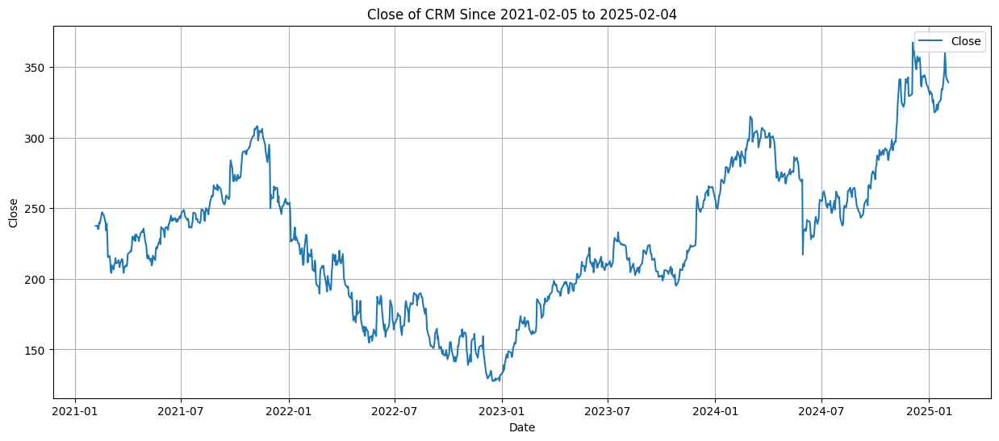

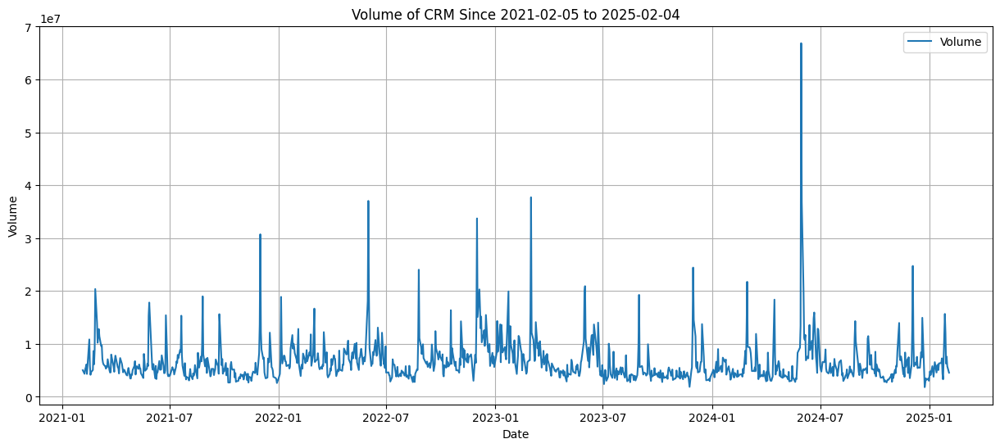

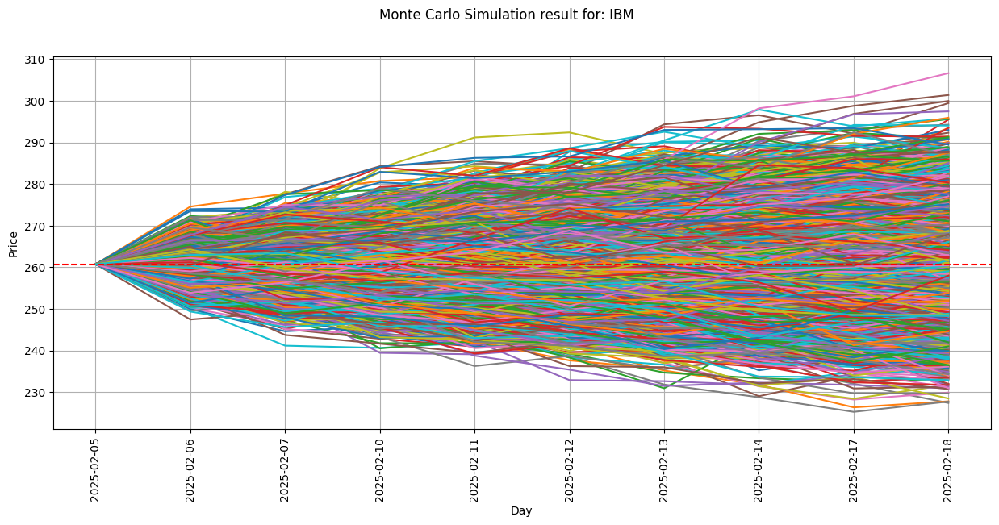

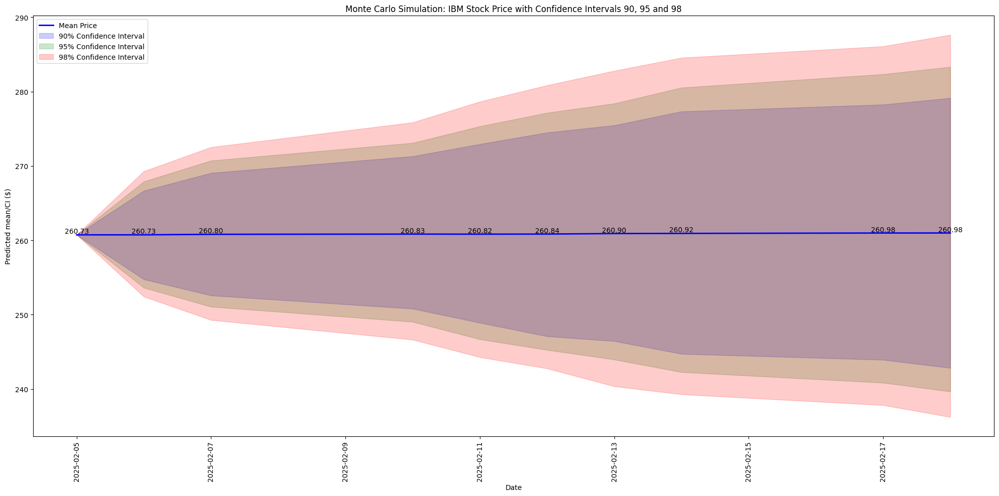

ZS: The mean price 2025-02-05 is: 200.0, The 95% CI price: (200.0, 200.0), The 98% CI price: (200.0, 200.0)
ZS: The mean price 2025-02-06 is: 199.88, The 95% CI price: (186.0, 213.36), The 98% CI price: (183.7, 216.0)
ZS: The mean price 2025-02-07 is: 199.78, The 95% CI price: (180.99, 218.69), The 98% CI price: (176.52, 223.58)
ZS: The mean price 2025-02-10 is: 199.74, The 95% CI price: (176.89, 224.52), The 98% CI price: (173.22, 228.46)
ZS: The mean price 2025-02-11 is: 199.95, The 95% CI price: (173.6, 229.02), The 98% CI price: (169.48, 233.9)
ZS: The mean price 2025-02-12 is: 200.06, The 95% CI price: (170.72, 232.26), The 98% CI price: (166.18, 237.83)
ZS: The mean price 2025-02-13 is: 200.08, The 95% CI price: (167.81, 235.63), The 98% CI price: (163.42, 242.99)
ZS: The mean price 2025-02-14 is: 200.06, The 95% CI price: (165.95, 239.63), The 98% CI price: (160.42, 247.3)
ZS: The mean price 2025-02-17 is: 200.11, The 95% CI price: (163.78, 242.57), The 98% CI price: (157.65, 25

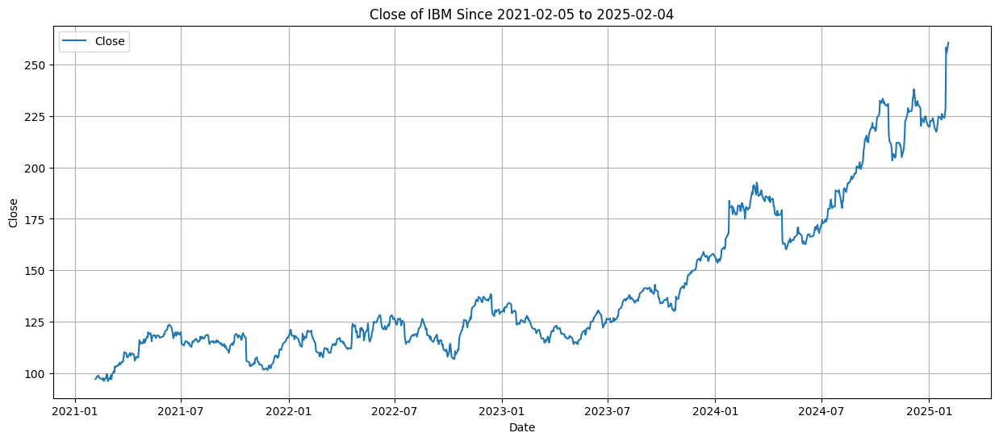

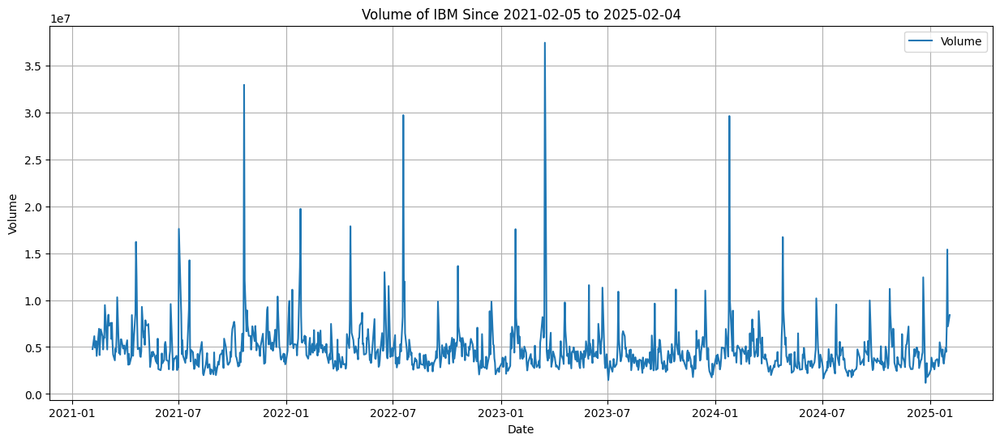

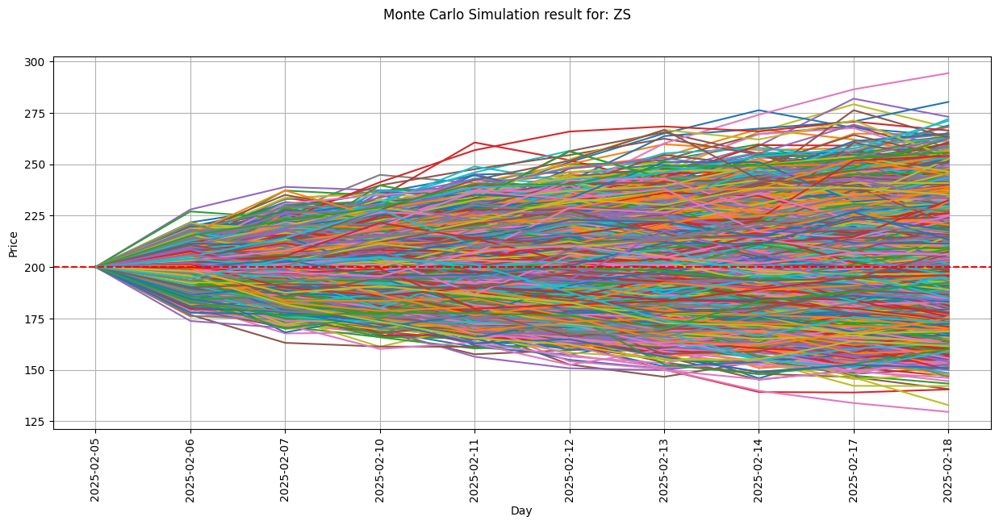

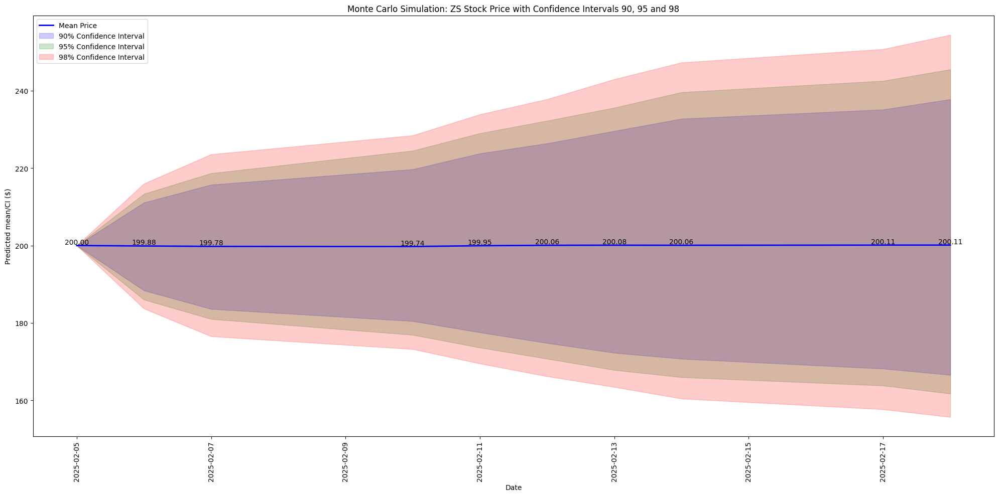

PYPL: The mean price 2025-02-05 is: 89.51, The 95% CI price: (89.51, 89.51), The 98% CI price: (89.51, 89.51)
PYPL: The mean price 2025-02-06 is: 89.54, The 95% CI price: (84.77, 94.33), The 98% CI price: (83.66, 95.29)
PYPL: The mean price 2025-02-07 is: 89.56, The 95% CI price: (82.84, 96.53), The 98% CI price: (81.6, 97.87)
PYPL: The mean price 2025-02-10 is: 89.59, The 95% CI price: (81.47, 98.15), The 98% CI price: (80.05, 99.95)
PYPL: The mean price 2025-02-11 is: 89.6, The 95% CI price: (80.45, 99.59), The 98% CI price: (78.92, 101.85)
PYPL: The mean price 2025-02-12 is: 89.59, The 95% CI price: (79.24, 101.06), The 98% CI price: (77.78, 103.45)
PYPL: The mean price 2025-02-13 is: 89.59, The 95% CI price: (78.27, 102.28), The 98% CI price: (76.77, 104.51)
PYPL: The mean price 2025-02-14 is: 89.59, The 95% CI price: (77.39, 102.99), The 98% CI price: (75.6, 105.59)
PYPL: The mean price 2025-02-17 is: 89.56, The 95% CI price: (76.64, 103.99), The 98% CI price: (74.62, 107.23)
PYPL

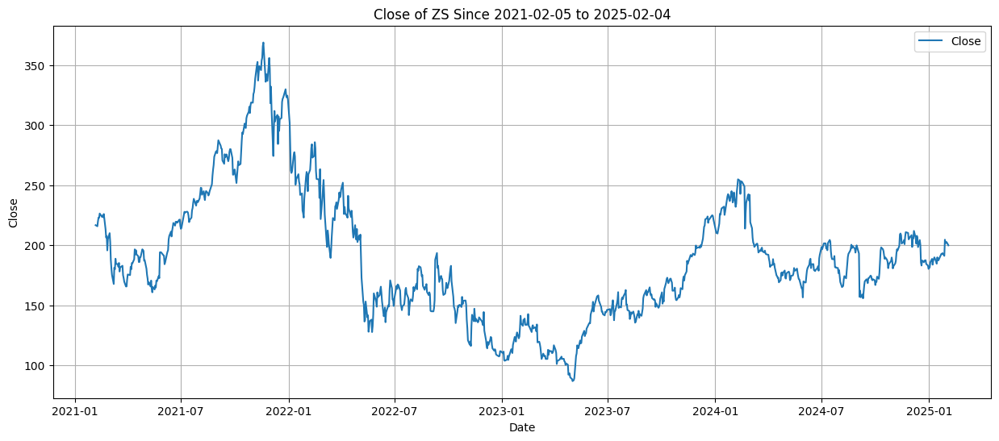

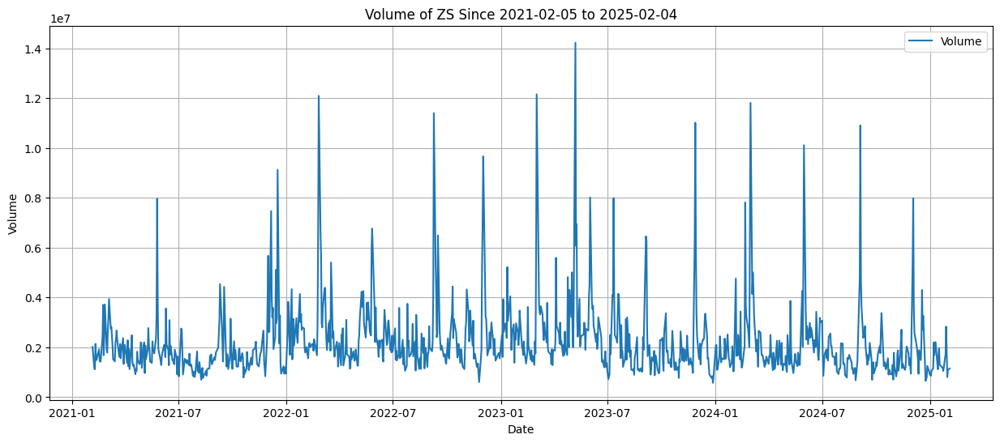

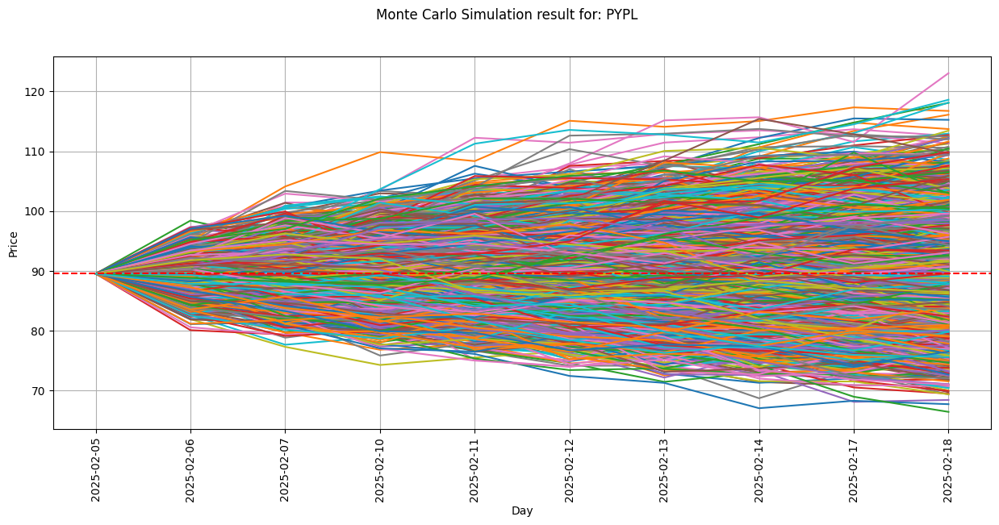

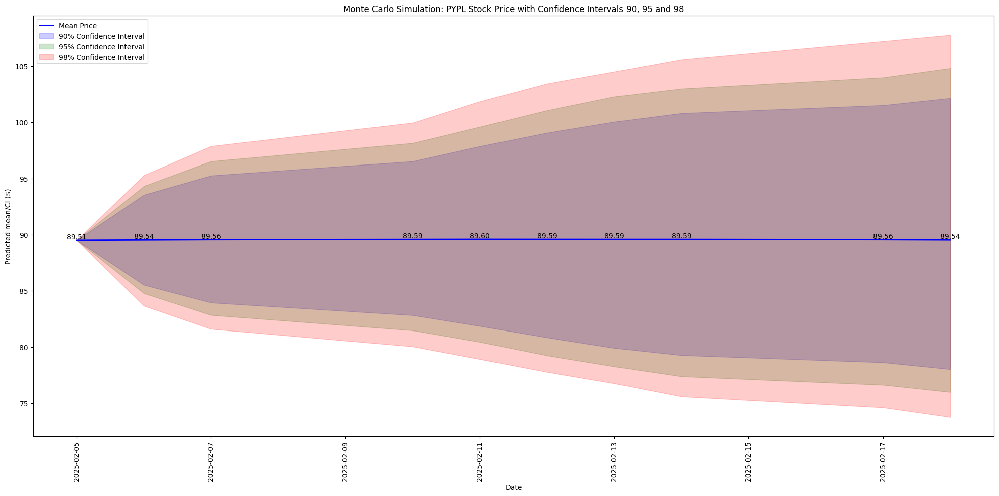

MU: The mean price 2025-02-05 is: 89.92, The 95% CI price: (89.92, 89.92), The 98% CI price: (89.92, 89.92)
MU: The mean price 2025-02-06 is: 89.97, The 95% CI price: (84.89, 94.94), The 98% CI price: (83.96, 95.63)
MU: The mean price 2025-02-07 is: 89.9, The 95% CI price: (83.0, 97.2), The 98% CI price: (81.7, 98.4)
MU: The mean price 2025-02-10 is: 89.92, The 95% CI price: (81.53, 98.79), The 98% CI price: (79.75, 100.87)
MU: The mean price 2025-02-11 is: 89.95, The 95% CI price: (80.16, 100.2), The 98% CI price: (78.58, 102.46)
MU: The mean price 2025-02-12 is: 89.92, The 95% CI price: (79.21, 101.36), The 98% CI price: (76.85, 104.08)
MU: The mean price 2025-02-13 is: 89.97, The 95% CI price: (78.11, 102.24), The 98% CI price: (76.3, 105.23)
MU: The mean price 2025-02-14 is: 90.0, The 95% CI price: (77.56, 103.7), The 98% CI price: (75.7, 106.5)
MU: The mean price 2025-02-17 is: 90.0, The 95% CI price: (76.78, 104.63), The 98% CI price: (74.64, 108.28)
MU: The mean price 2025-02-18

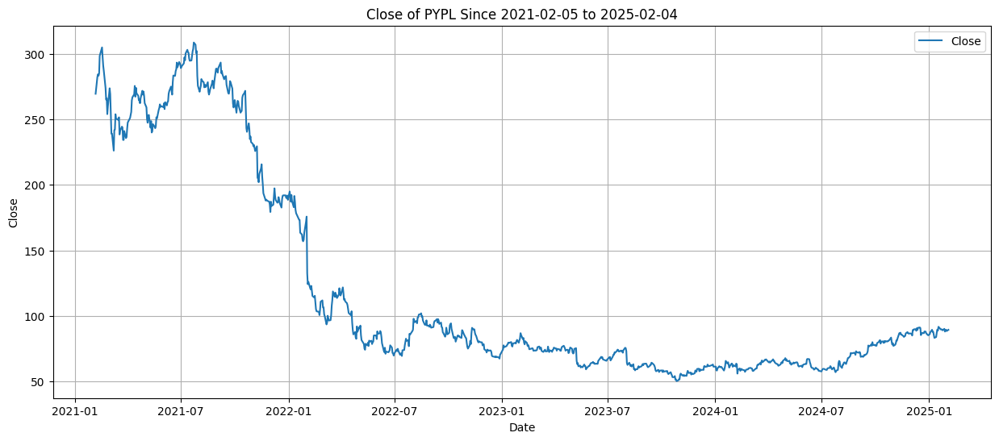

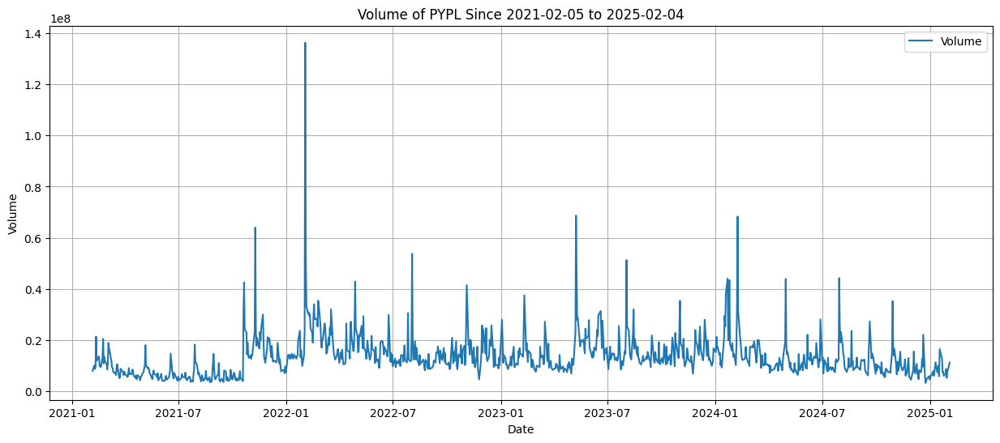

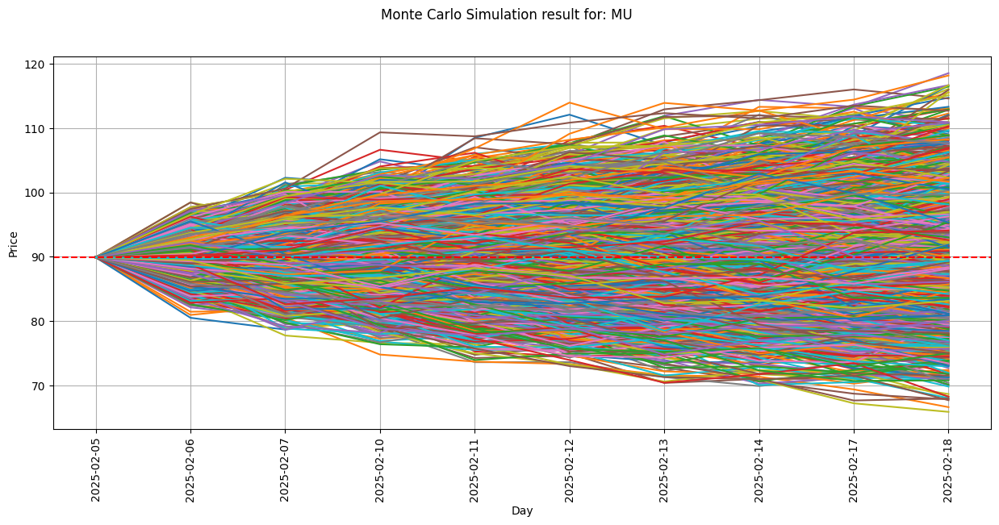

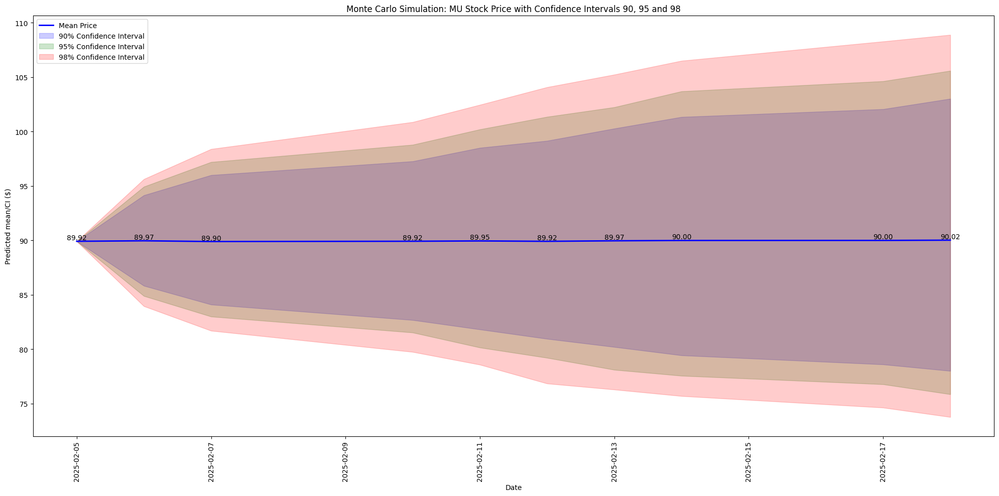

ADBE: The mean price 2025-02-05 is: 438.6, The 95% CI price: (438.6, 438.6), The 98% CI price: (438.6, 438.6)
ADBE: The mean price 2025-02-06 is: 438.72, The 95% CI price: (419.64, 458.46), The 98% CI price: (415.46, 461.72)
ADBE: The mean price 2025-02-07 is: 438.59, The 95% CI price: (410.84, 466.29), The 98% CI price: (405.24, 472.54)
ADBE: The mean price 2025-02-10 is: 438.7, The 95% CI price: (405.09, 473.53), The 98% CI price: (398.34, 479.9)
ADBE: The mean price 2025-02-11 is: 438.62, The 95% CI price: (399.94, 478.15), The 98% CI price: (393.8, 485.0)
ADBE: The mean price 2025-02-12 is: 438.74, The 95% CI price: (396.28, 483.68), The 98% CI price: (389.76, 493.18)
ADBE: The mean price 2025-02-13 is: 438.78, The 95% CI price: (393.14, 488.96), The 98% CI price: (383.62, 498.34)
ADBE: The mean price 2025-02-14 is: 438.62, The 95% CI price: (389.27, 491.96), The 98% CI price: (380.83, 503.07)
ADBE: The mean price 2025-02-17 is: 438.58, The 95% CI price: (386.23, 494.83), The 98% C

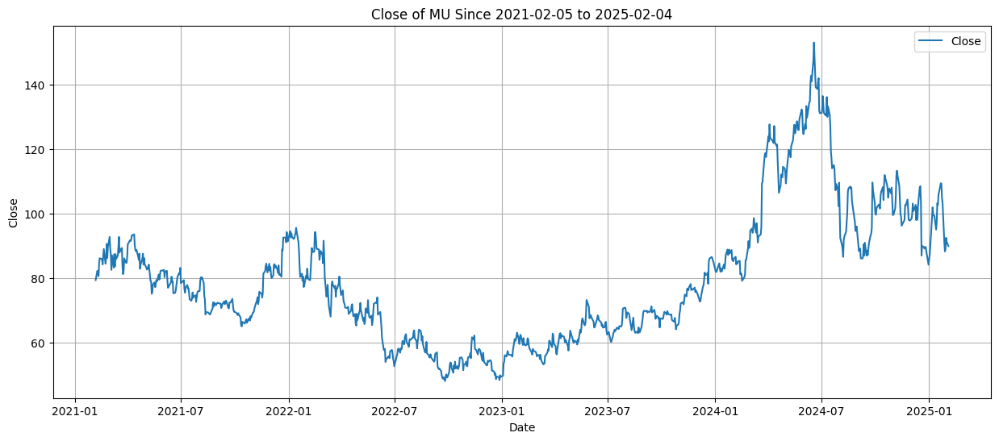

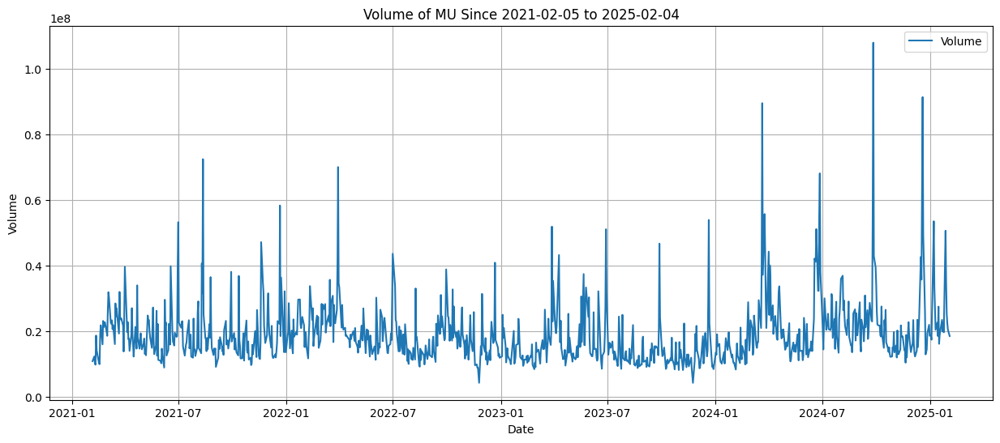

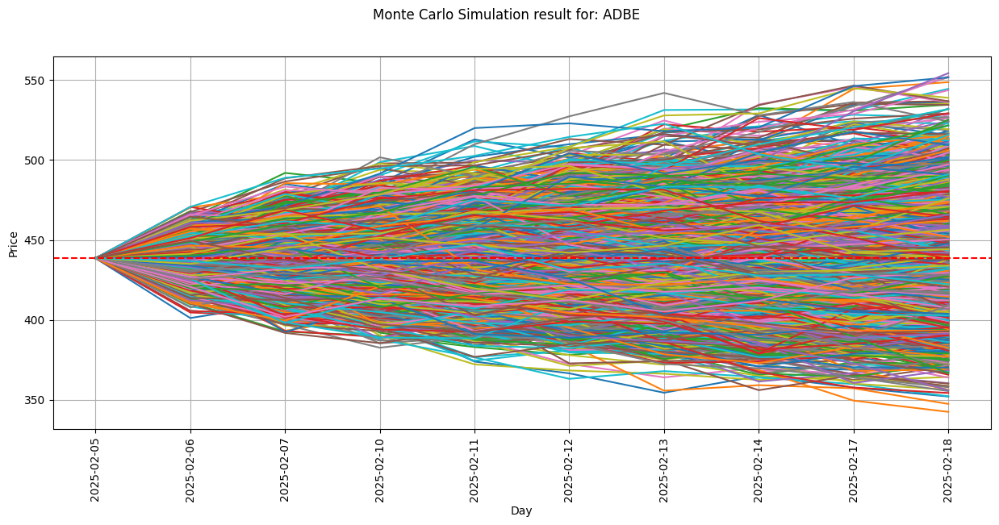

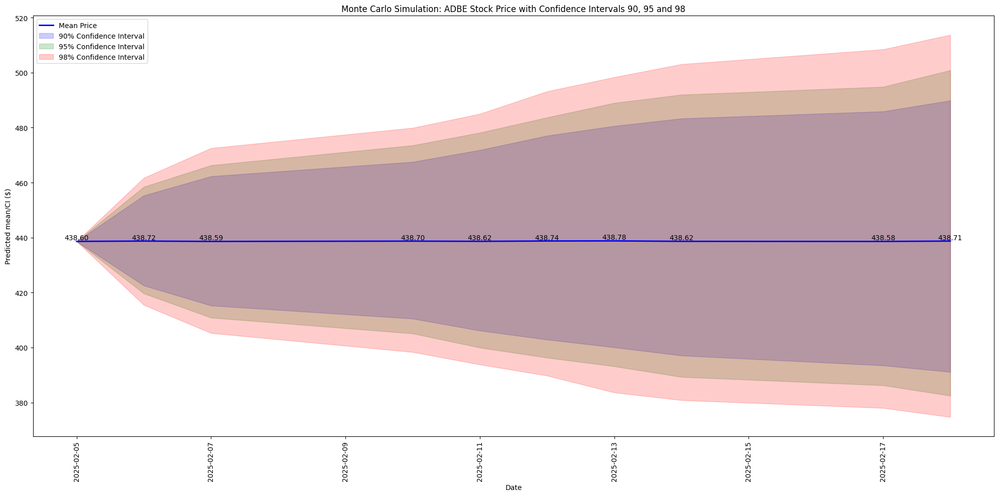

INTU: The mean price 2025-02-05 is: 600.76, The 95% CI price: (600.76, 600.76), The 98% CI price: (600.76, 600.76)
INTU: The mean price 2025-02-06 is: 600.71, The 95% CI price: (575.22, 626.48), The 98% CI price: (570.05, 631.28)
INTU: The mean price 2025-02-07 is: 600.68, The 95% CI price: (565.23, 637.03), The 98% CI price: (559.34, 644.27)
INTU: The mean price 2025-02-10 is: 600.48, The 95% CI price: (556.92, 645.93), The 98% CI price: (549.86, 655.67)
INTU: The mean price 2025-02-11 is: 600.66, The 95% CI price: (551.53, 651.53), The 98% CI price: (541.47, 665.21)
INTU: The mean price 2025-02-12 is: 600.6, The 95% CI price: (544.39, 658.94), The 98% CI price: (534.58, 671.73)
INTU: The mean price 2025-02-13 is: 600.6, The 95% CI price: (539.57, 665.35), The 98% CI price: (526.97, 678.04)
INTU: The mean price 2025-02-14 is: 600.86, The 95% CI price: (535.16, 670.35), The 98% CI price: (523.5, 686.19)
INTU: The mean price 2025-02-17 is: 601.01, The 95% CI price: (530.22, 674.72), The

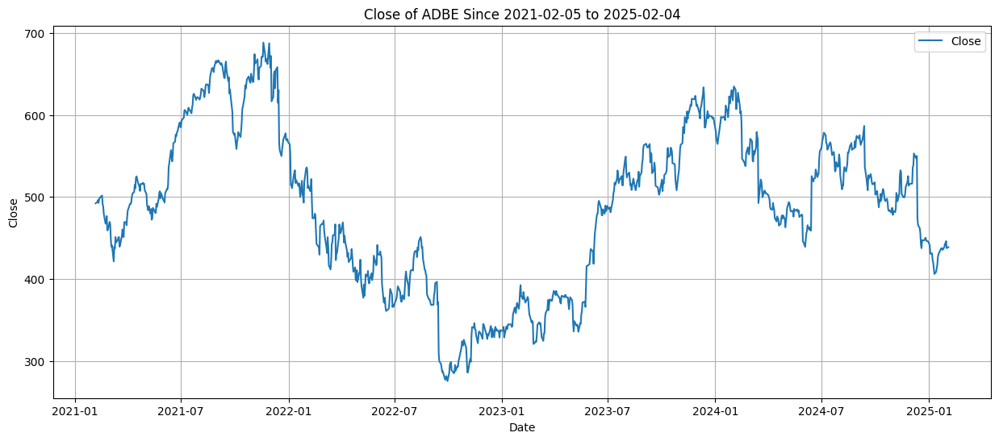

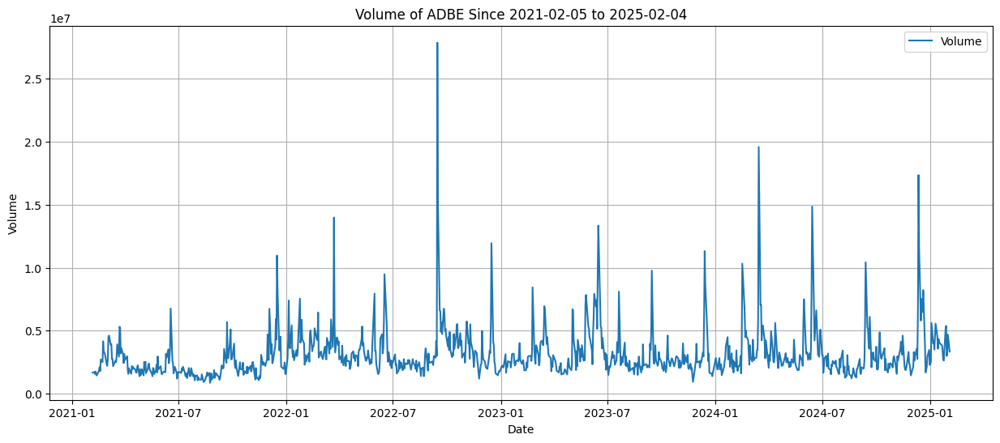

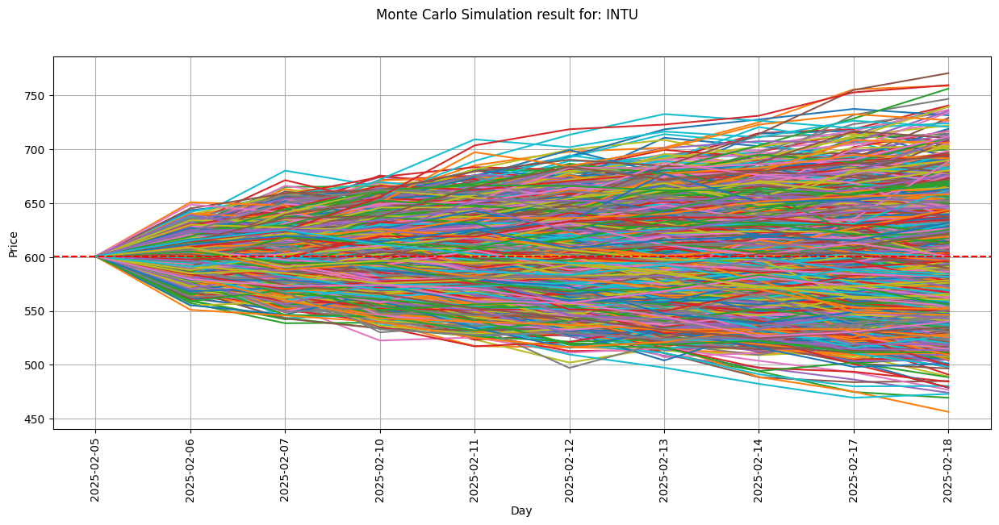

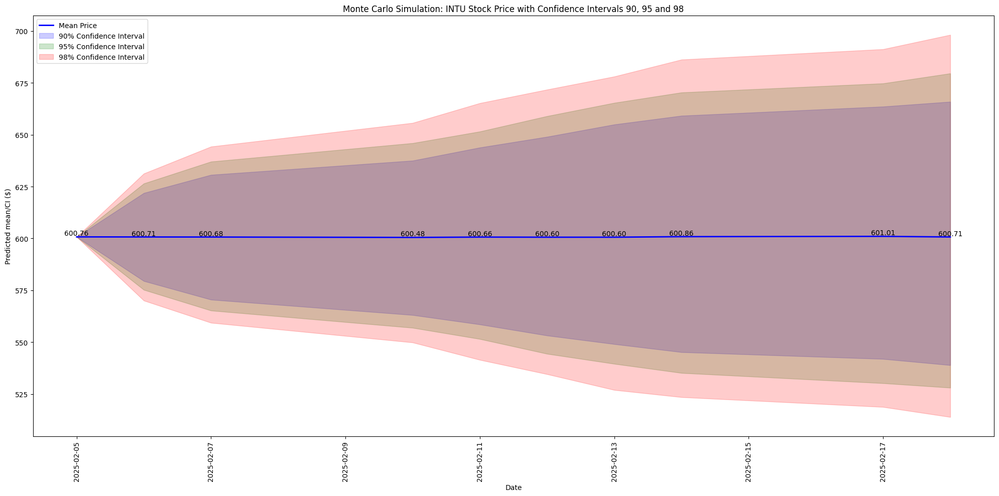

NOW: The mean price 2025-02-05 is: 1020.94, The 95% CI price: (1020.94, 1020.94), The 98% CI price: (1020.94, 1020.94)
NOW: The mean price 2025-02-06 is: 1021.11, The 95% CI price: (969.58, 1073.21), The 98% CI price: (960.77, 1081.84)
NOW: The mean price 2025-02-07 is: 1020.76, The 95% CI price: (951.33, 1094.5), The 98% CI price: (938.5, 1105.58)
NOW: The mean price 2025-02-10 is: 1020.98, The 95% CI price: (934.63, 1110.61), The 98% CI price: (921.39, 1129.96)
NOW: The mean price 2025-02-11 is: 1020.98, The 95% CI price: (924.6, 1123.2), The 98% CI price: (904.51, 1149.27)
NOW: The mean price 2025-02-12 is: 1020.79, The 95% CI price: (912.65, 1137.89), The 98% CI price: (895.33, 1164.97)
NOW: The mean price 2025-02-13 is: 1020.9, The 95% CI price: (903.61, 1149.46), The 98% CI price: (884.46, 1173.22)
NOW: The mean price 2025-02-14 is: 1020.92, The 95% CI price: (894.34, 1160.3), The 98% CI price: (873.37, 1187.67)
NOW: The mean price 2025-02-17 is: 1020.7, The 95% CI price: (885.44

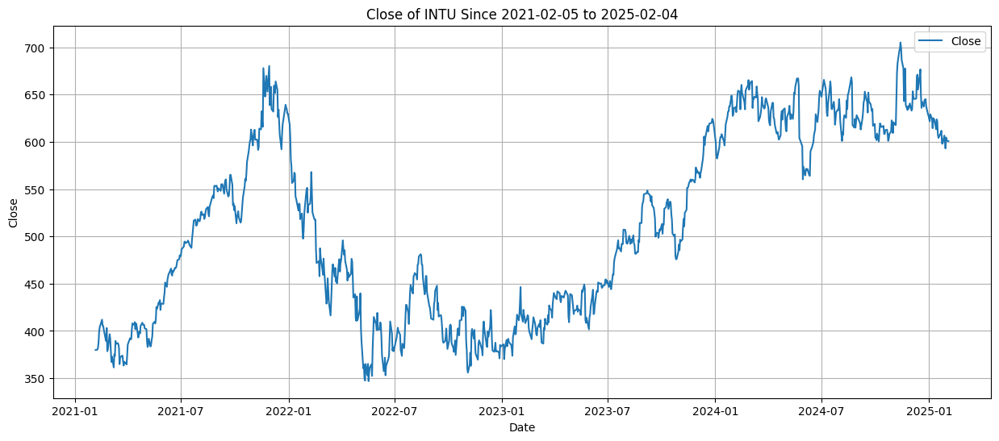

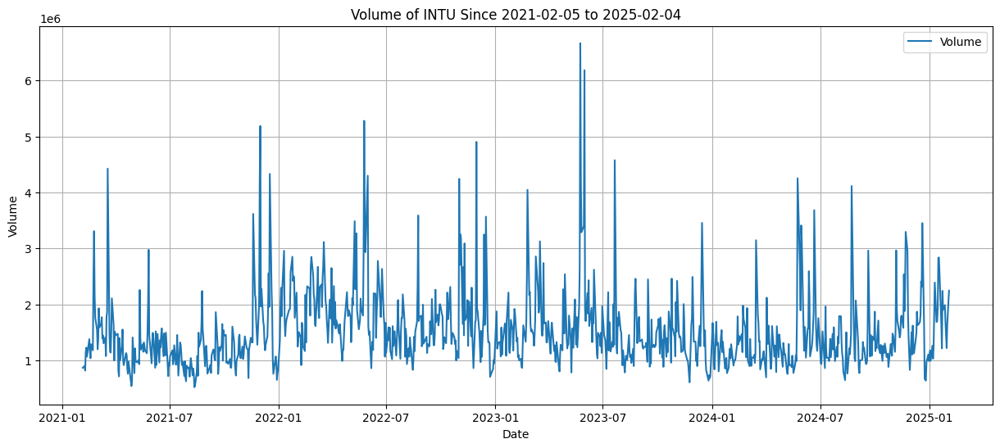

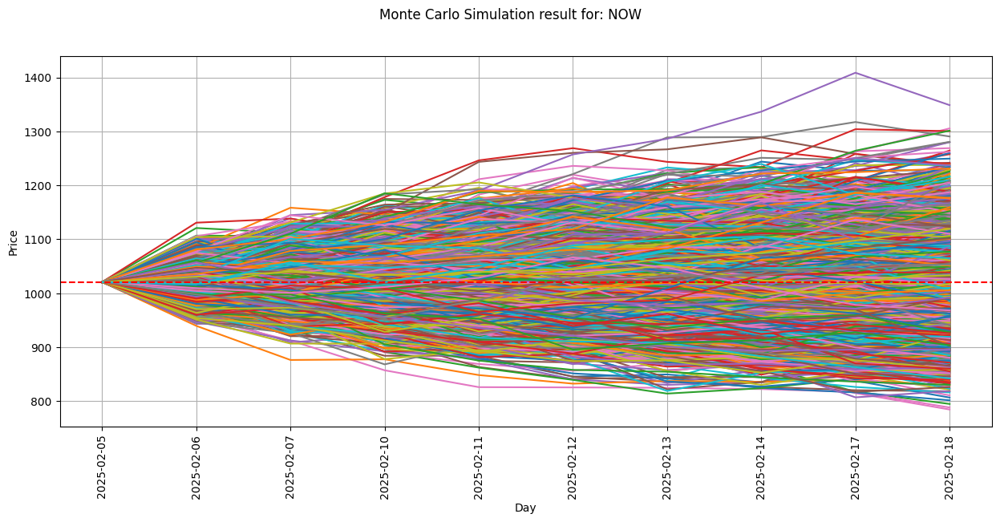

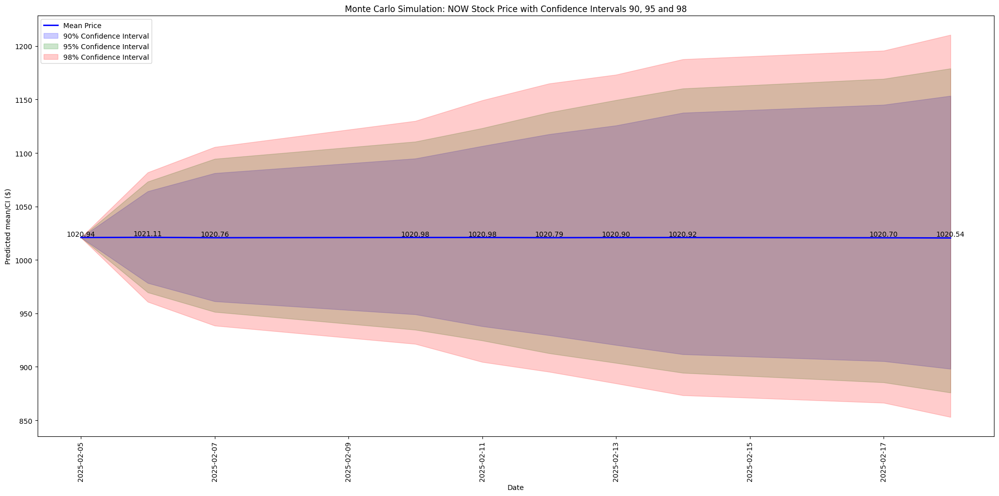

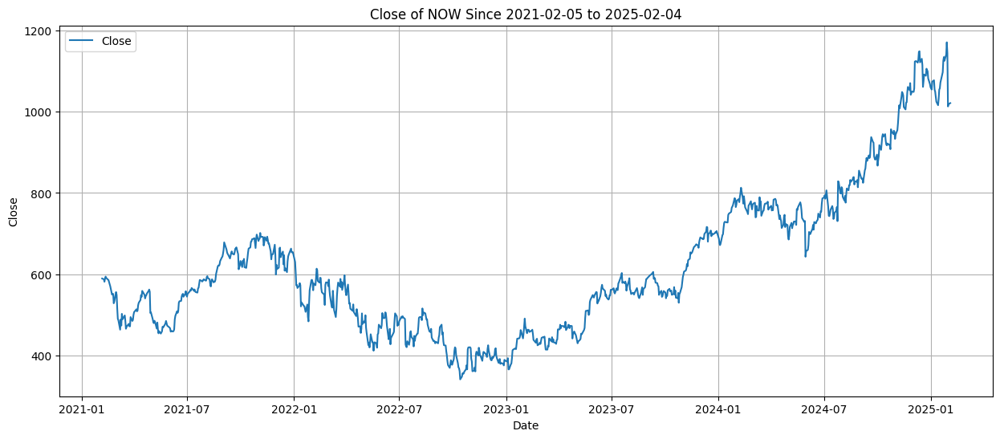

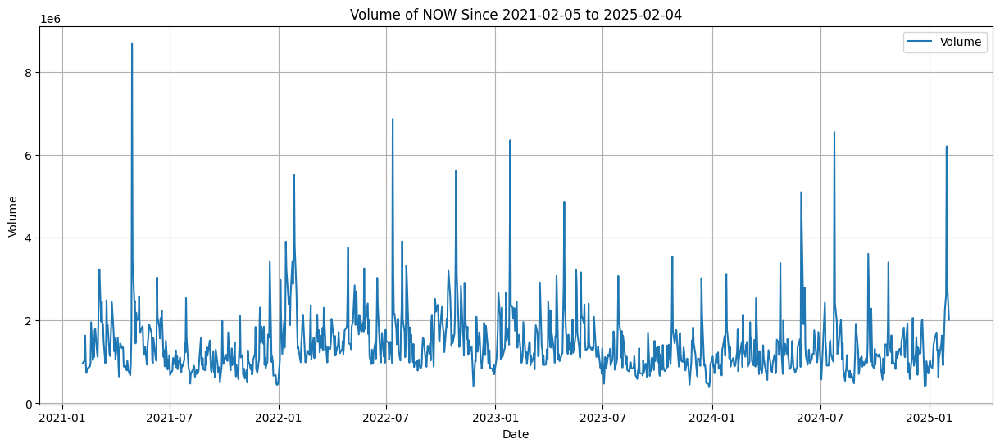

In [5]:
#@title Execute Monte Carlo simulation using Monte_Carlo_Sim class for NASDAQ AI stocks
nasdaq_ai_stocks = [
    'GOOG',  # Alphabet (Google)
    'GOOGL', # Alphabet (Google)
    'NVDA',  # NVIDIA Corporation
    'MSFT',  # Microsoft Corporation
    'AMZN',  # Amazon.com, Inc.
    'AAPL',  # Apple Inc.
    'INTC',  # Intel Corporation
    'META',  # Meta Platforms, Inc. (formerly Facebook)
    'AMD',   # Advanced Micro Devices, Inc.
    'BA',    # Boeing (AI applications in manufacturing)
    'TSLA',  # Tesla, Inc. (AI in autonomous driving)
    'ORCL',  # Oracle Corporation
    'CRM',   # Salesforce.com, Inc. (AI for CRM tools)
    'IBM',   # International Business Machines Corporation
    'ZS',    # Zscaler, Inc. (AI in cybersecurity)
    'PYPL',  # PayPal Holdings, Inc. (AI in payment processing)
    'MU',    # Micron Technology, Inc. (AI in memory products)
    'ADBE',  # Adobe Inc. (AI in creative and marketing solutions)
    'INTU',  # Intuit Inc. (AI for personal finance and accounting)
    'NOW'    # ServiceNow, Inc. (AI in workflow automation)
]

# Get today's date
today = datetime.now().strftime('%Y-%m-%d')
# Convert today's date to a pandas datetime object
today_date = pd.to_datetime(today)
# Get the previous business day
previous_business_day = today_date - pd.offsets.BDay(1)
# Format the previous business day as a string
previous_business_day_str = previous_business_day.strftime('%Y-%m-%d')

end_date = previous_business_day_str  # previous businesss date in YYYY-MM-DD format
start_date = (previous_business_day - timedelta(days=4*365)).strftime('%Y-%m-%d')  # 4 years before the last business day


# dict to jhold results
results = {}

# Loop through each ticker and run the simulation
for ticker in nasdaq_ai_stocks:
    simulation = Monte_Carlo_Sim(ticker, start_date, end_date, 10, 5000)
    simulation.calculate_percentile_price_for_days()
    simulation.simulation_plot()
    simulation.plot_CI_price()
    simulation.plot_stock_data_column('Close')
    simulation.plot_stock_data_column('Volume')